__Arctic Sea Ice Analysis__

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math

from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

__Load Data Sources__

In this project, we will by analyzing the Arctic Sea Ice, and try to detect any long term trends.  We don't have an intial clean dataset to work with, so we will have to create our own.  There are various datasets that we will want to combine into one and clean up before we do any analyzing.  These include daily sea ice volume, daily average sea ice thickness, and daily sea ice extent.  We also will include monthly average air temperature, monthly average sea surface temperature within the Arctic Circle. Finally, we'll include daily atmospheric carbon dioxide and methane levels at the Barrow Atmospheric Baseline Observatory, located on the northern coast of Alaska.  There is much more data out there, such as Arctic Sea Ice age, concentration, velocity, etc., but for now we will focus on what we have.

In total, we have two .dat files, three .csv files, and two .txt files.

In [2]:
# Dataset file path variables
volume_file = "./data/PIOMAS.vol.daily.1979.2020.Current.v2.1.dat"
thickness_file = "./data/PIOMAS.thick.daily.1979.2020.Current.v2.1.dat"
extent_file = "./data/N_seaice_extent_daily_v3.csv"
air_temperature_file = "./data/air_temperature.csv"
sea_surface_temperature_file = "./data/sea_surface_temperature.csv"
carbon_dioxide_file = "./data/co2_brw_surface-insitu_1_ccgg_DailyData.txt"
methane_file = "./data/ch4_brw_surface-insitu_1_ccgg_DailyData.txt"

__Volume__

First we will load the daily Arctic Sea Ice volume dataset from the PIOMAS (Pan-Arctic Ice Ocean Modeling and Assimilation System), part of the Polar Science Center at the University of Washington.  This data contains the best estimates of daily Arctic Sea Ice volume since January 1st, 1979.  The data is sorted by year, and the day number of the year.  We want our dataset to be organized by year, month, and day of month, so we will need to format it as such.  PIOMAS also notes that the data only contains 365 days a year of data, so leap years will not have a data point for the last day of the year, December 31st.  The unit of measurement for this data is 1,000 cubic kilometers.

This data can be downloaded at http://psc.apl.uw.edu/wordpress/wp-content/uploads/schweiger/ice_volume/PIOMAS.vol.daily.1979.2020.Current.v2.1.dat.gz 
or can be found at http://psc.apl.uw.edu/research/projects/arctic-sea-ice-volume-anomaly/data/

More information about the dataset can be found at:
http://psc.apl.uw.edu/research/projects/arctic-sea-ice-volume-anomaly/ 

and more information about the model can be found at:
https://journals.ametsoc.org/doi/full/10.1175/1520-0493%282003%29131%3C0845%3AMGSIWA%3E2.0.CO%3B2

In [3]:
# year_day_to_month_day() takes a year, and the day number of the year, and from it determines and returns the month 
# and day of month.
def year_day_to_month_day(day_number, year):
    # determine if leap year needs to be taken into account
    leap_year = int(year % 4 == 0)
    # determine from day number of year which month and day of month it is
    if day_number <= 31:
        month = 1
        day = day_number
    elif day_number <= 59 + leap_year:
        month = 2
        day = day_number - 31
    elif day_number <= 90 + leap_year:
        month = 3
        day = day_number - 59 - leap_year
    elif day_number <= 120 + leap_year:
        month = 4
        day = day_number - 90 - leap_year
    elif day_number <= 151 + leap_year:
        month = 5
        day = day_number - 120 - leap_year
    elif day_number <= 181 + leap_year:
        month = 6
        day = day_number - 151 - leap_year
    elif day_number <= 212 + leap_year:
        month = 7
        day = day_number - 181 - leap_year
    elif day_number <= 243 + leap_year:
        month = 8
        day = day_number - 212 - leap_year
    elif day_number <= 273 + leap_year:
        month = 9
        day = day_number - 243 - leap_year
    elif day_number <= 304 + leap_year:
        month = 10
        day = day_number - 273 - leap_year
    elif day_number <= 334 + leap_year:
        month = 11
        day = day_number - 304 - leap_year
    else:
        month = 12
        day = day_number - 334 - leap_year
    return month, day

# load_piomas_data() will take a dataset from PIOMAS, and format it to have a column each for year, month, day, in
# addition to the measurement type recorded in the dataset
def load_piomas_data(file, measurement_type):
    # load in dataset and prepare for data manipulation
    years = []
    months = []
    days = []
    measurements = []
    piomas_df = pd.read_csv(file)
    piomas_df.columns = ["Daily Data"]
    daily_data = list(piomas_df["Daily Data"])
    # for each data point, determine year, month, day of month, and meausrement
    for data_point in daily_data:
        day_data = data_point.split()
        year = int(day_data[0])
        month, day = year_day_to_month_day(int(day_data[1]), year)
        measurement = float(day_data[2])
        years.append(year)
        months.append(month)
        days.append(day)
        measurements.append(measurement)
    # create dataframe with desired format
    piomas_df = pd.DataFrame(zip(years, months, days, measurements))
    piomas_df.columns = ["Year", "Month", "Day", measurement_type]
    return piomas_df

# since there is not a great way of keeping track of units without plugging them into the column headers, we will 
# instead simply maintain a dictionary of units
units = {}
units["Volume"] = "[10^3 cubic km]"
# load and display volume dataset
arctic_sea_ice_df = load_piomas_data(volume_file, "Volume")
arctic_sea_ice_df

,Year,Month,Day,Volume
0,1979,1,1,26.405
1,1979,1,2,26.496
2,1979,1,3,26.582
3,1979,1,4,26.672
4,1979,1,5,26.770
...,...,...,...,...
15051,2020,3,27,22.557
15052,2020,3,28,22.596
15053,2020,3,29,22.640
15054,2020,3,30,22.692


__Thickness__

Next we will load the daily average Arctic Sea Ice thickness.  This contains the average of ice that is at least 0.15 meters thick.  This data also comes from PIOMAS, and thus has the same domain, format, and considerations as the volume data.  The unit of measurement for this data is meters.

This data can be downloaded at http://psc.apl.uw.edu/wordpress/wp-content/uploads/schweiger/ice_volume/PIOMAS.thick.daily.1979.2020.Current.v2.1.dat.gz 

or can be found at http://psc.apl.uw.edu/research/projects/arctic-sea-ice-volume-anomaly/data/

There are multiple datasets out there that contain Arctic Sea Ice thickness.  The following is an interesting paper that compares some of them with each other, including PIOMAS thickness:
https://www.mdpi.com/2072-4292/8/9/713

In [4]:
# load and merge thickness dataset
units["Thickness"] = "[m]"
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, load_piomas_data(thickness_file, "Thickness"), how="outer", 
                             left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness
0,1979,1,1,26.405,1.951
1,1979,1,2,26.496,1.955
2,1979,1,3,26.582,1.962
3,1979,1,4,26.672,1.965
4,1979,1,5,26.770,1.973
...,...,...,...,...,...
15051,2020,3,27,22.557,1.701
15052,2020,3,28,22.596,1.704
15053,2020,3,29,22.640,1.707
15054,2020,3,30,22.692,1.712


__Extent__

The next dataset we will load is the daily Arctic Sea Ice extent.  This is similar to sea ice area, however, it includes as part of its measurement any ice free pockets that are within the Arctic sea ice.  Think of the differnce between extent and area as the difference between measuring the size of a piece of swiss cheese (holes included) versus measuring only how much swiss cheese there actually is (so excluding the holes).  This dataset comes from the NSIDC (National Snow and Ice Data Center), part of the Cooperative Institude for Research in Environmental Sciences at the University of Colorado at Boulder.  This dataset luckily already is formatted the way we desire, with a column each for year, month, and day of month.  However, this dataset also proposes some challenges the we will have to consider before analyzation.  The first data point in this data set is October 26, 1978, and only has a data point every OTHER day afterwards, until August 20, 1987.  At this point, there is a data point taken every day.  However, there are no data points at all from December 3, 1987 through January 12, 1988, a timespan little over a month.  This is all due to two separate satellite systems (SMMR and SSM/I) recording the data, the second of which was launched in 1987.  For now we will just load the data, and come back to how we will work with this unique situation.  The unit of measurement for this data is 1,000,000 square kilometers.

This data can be found at https://nsidc.org/data/seaice_index/archives, under the "Data" tab, and can be downloaded when you click the link called "Northern Hemisphere Daily Data File" under the "Daily Sea Ice Extent Data Files" section.

An explanation of how this data is measured from satellites can be found here:
https://nsidc.org/cryosphere/sotc/sea_ice.html

In [5]:
# load_extent_data() takes the extent dataset from the NSIDC and loads it into a dataframe, while only keeping the 
# desired columns of year, month, day of month, and measurement
def load_extent_data(extent_file):
    extent_df = pd.read_csv(extent_file)
    # drop last two columns that we don't care about
    extent_df = extent_df.drop(extent_df.columns[len(extent_df.columns)-1], axis=1)
    extent_df = extent_df.drop(extent_df.columns[len(extent_df.columns)-1], axis=1)
    # drop row that contains units
    extent_df = extent_df.drop(extent_df.index[0])
    # rename columns and load date data as integers
    extent_df.columns = ["Year", "Month", "Day", "Extent"]
    extent_df["Day"] = extent_df["Day"].astype(int)
    extent_df["Month"] = extent_df["Month"].astype(int)
    extent_df["Year"] = extent_df["Year"].astype(int)
    extent_df["Extent"] = extent_df["Extent"].astype(float)
    return extent_df

# load and merge extent dataset
units["Extent"] = "[10^6 sq km]"
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, load_extent_data(extent_file), how="outer", 
                             left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent
0,1979,1,1,26.405,1.951,NaN
1,1979,1,2,26.496,1.955,14.997
2,1979,1,3,26.582,1.962,NaN
3,1979,1,4,26.672,1.965,14.922
4,1979,1,5,26.770,1.973,NaN
...,...,...,...,...,...,...
15124,2020,4,26,NaN,NaN,13.266
15125,2020,4,27,NaN,NaN,13.262
15126,2020,4,28,NaN,NaN,13.349
15127,2020,4,29,NaN,NaN,13.329


__Air Temperature__

Up next are datasets available through the PSL (Physical Sciences Laboratory) at the NOAA (National Oceanic and Atmospheric Administration), which is part of the United States Federal Government.  They have all different kinds of data available for download at https://psl.noaa.gov/cgi-bin/data/testdap/timeseries.pl

Since one of the many variables that determines how much Arctic sea ice there is is temperature, we would like to get some data on the air temperature in the Arctic, as well as sea surface temperature.  Luckily for us, datasets for both can be found with the PSL at NOAA.  First, we will download the Berkeley Earth dataset that contains the average monthly air temperatures at a height of 2 meters.  The values in this dataset are the air temperature __anomalies__ with respect to a 1981-2010 baseline.  We will only grab the air temperatures that are within the Arctic Circle, so at latitudes greater than 66.5 degrees (due to the tilt of the Earth being 23.5 degrees).  Unfortunately this data is monthly instead of daily, but we have to work with what we are given.  We also are only going to grab air temperatures that are over the ocean (which means excluding land air temperatures) since we are mainly concerned with the Arctic Sea Ice.  Luckily for us, the dataset also extends back to 1978.  Since our desired dataset format is a data point for each day, when we load this dataset, we will copy the monthly average value into every row for that given month.  We also need to manipulate the dataset since the date is in a single column, and we would like to have three separate columns for the dates.  The units for this data is degrees Celsius.

This dataset can be generated with this query:

https://psl.noaa.gov/cgi-bin/data/testdap/timeseries.proc.pl?dataset1=Berkeley&dataset2=none&var=2m+Air+Temperature&level=1000mb&pgT1Sel=10&pgtTitle1=&pgtPath1=&level2=1000mb&pgT2Sel=10&pgtTitle2=&pgtPath2=&fyear=1979&fyear2=2020&season=0&fmonth=0&fmonth2=11&type=0&climo1yr1=1981&climo1yr2=2010&climo2yr1=1981&climo2yr2=2010&xlat1=66.5&xlat2=90&xlon1=0&xlon2=360&maskx=2&zlat1=0&zlat2=90&zlon1=0&zlon2=360&maskx2=0&map=on&yaxis=0&bar=0&smooth=0&runmean=1&yrange1=0&yrange2=0&y2range1=0&y2range2=0&xrange1=0&xrange2=0&markers=0&legend=0&ywave1=&ywave2=&cwavelow=&cwavehigh=&cwaveint=&coi=0&Submit=Create+Plot

From there, you can download the .csv file to get the dataset.

More information about the dataset itself can be found at: https://climatedataguide.ucar.edu/climate-data/global-surface-temperatures-best-berkeley-earth-surface-temperatures

In [6]:
# days_in_month() will determine how many days are in a given month and year
def days_in_month(month, year):
    months_31 = [1, 3, 5, 7, 8, 10, 12]
    months_30 = [4, 6, 9, 11]
    if month in months_31:
        return 31
    if month in months_30:
        return 30
    # take into account if the year is a leap year
    if year % 4:
        return 28
    return 29

# load_temperature_data() will take a temperature data file taken from the PSL at NOAA, and manipulate it into the 
# desired format, with a column each for year, month, day of month, and temperature.  Since the data is monthly, this
# will copy the temperature value for a given month into each row for that month.
def load_temperature_data(file, temperature_type):
    # load file and prepare for data manipulation
    temperature_df = pd.read_csv(file)
    temperature_df.columns = ["Date", temperature_type]
    years = []
    months = []
    days = []
    temperatures = []
    temperature_index = 0
    dates = list(temperature_df["Date"])
    # for each date, split it up into the individual year, month, and day data
    for date in dates:
        date = date.split("-")
        year = int(date[0])
        month = int(date[1])
        number_of_days = days_in_month(month, year)
        # prepare temperature data for easy dataframe creation
        for day in range(1, number_of_days+1):
            years.append(year)
            months.append(month)
            days.append(day)
            temperatures.append(float(temperature_df[temperature_type][temperature_index]))
        temperature_index += 1
    # create and return temperature dataframe
    temperature_df = pd.DataFrame(zip(years, months, days, temperatures))
    temperature_df.columns = ["Year", "Month", "Day", temperature_type]
    return temperature_df

# load and merge air temperature dataset
units["Air Temperature"] = "[C]"
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, load_temperature_data(air_temperature_file, "Air Temperature"), 
                             how="outer", left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature
0,1979,1,1,26.405,1.951,NaN,0.317
1,1979,1,2,26.496,1.955,14.997,0.317
2,1979,1,3,26.582,1.962,NaN,0.317
3,1979,1,4,26.672,1.965,14.922,0.317
4,1979,1,5,26.770,1.973,NaN,0.317
...,...,...,...,...,...,...,...
15370,2020,12,27,NaN,NaN,NaN,-9999.000
15371,2020,12,28,NaN,NaN,NaN,-9999.000
15372,2020,12,29,NaN,NaN,NaN,-9999.000
15373,2020,12,30,NaN,NaN,NaN,-9999.000


__Sea Surface Temperature__

Now we will load in sea surface temperatures.  We will use the NOAA ERSSTV5 (Extended Reconstruction of Sea Surface Temperature) dataset which derives its data from the ICOADS (International Comprehensive Ocean-Atmosphere Data Set).  The structure of this dataset is the same as the air temperature dataset, however, the differences are that it computes its anomalies compared to a 1971-2000 baseline, and its units are in Kelvin.  We will quickly convert the data into Celsius for more consistency within our dataset.  Again, we will only take data from within the Arctic Circle.  Also, we again only have monthly averages, so we will manipulate this dataset in the same way we did the air temperature dataset.

This dataset can be generated with this query:

https://psl.noaa.gov/cgi-bin/data/testdap/timeseries.proc.pl?dataset1=NOAA+ERSST+V5&dataset2=none&var=Sea+Surface%2FSkin+Temp&level=1000mb&pgT1Sel=10&pgtTitle1=&pgtPath1=&var2=Geopotential+Height&level2=1000mb&pgT2Sel=10&pgtTitle2=&pgtPath2=&fyear=1978&fyear2=2020&season=0&fmonth=0&fmonth2=11&type=0&climo1yr1=1981&climo1yr2=2010&climo2yr1=1981&climo2yr2=2010&xlat1=66.5&xlat2=90&xlon1=0&xlon2=360&maskx=0&zlat1=0&zlat2=90&zlon1=0&zlon2=360&maskx2=0&map=on&yaxis=0&bar=0&smooth=0&runmean=1&yrange1=0&yrange2=0&y2range1=0&y2range2=0&xrange1=0&xrange2=0&markers=0&legend=0&ywave1=&ywave2=&cwavelow=&cwavehigh=&cwaveint=&coi=0&Submit=Create+Plot

From there, you can download the .csv file to get the dataset.

More information about this dataset can be found at: https://climatedataguide.ucar.edu/climate-data/sst-data-noaa-extended-reconstruction-ssts-version-4

In [7]:
# load and merge sea surface temperature dataset
units["Sea Surface Temperature"] = "[C]"
sea_surface_temperature_df = load_temperature_data(sea_surface_temperature_file, "Sea Surface Temperature")
# convert units from Kelvin to degrees Celsius
sea_surface_temperature_df["Sea Surface Temperature"] = sea_surface_temperature_df["Sea Surface Temperature"] - 273.15
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, sea_surface_temperature_df, how="outer", 
                             left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature
0,1979,1,1,26.405,1.951,NaN,0.317,-1.229
1,1979,1,2,26.496,1.955,14.997,0.317,-1.229
2,1979,1,3,26.582,1.962,NaN,0.317,-1.229
3,1979,1,4,26.672,1.965,14.922,0.317,-1.229
4,1979,1,5,26.770,1.973,NaN,0.317,-1.229
...,...,...,...,...,...,...,...,...
15701,1978,12,22,NaN,NaN,NaN,NaN,-1.095
15702,1978,12,24,NaN,NaN,NaN,NaN,-1.095
15703,1978,12,26,NaN,NaN,NaN,NaN,-1.095
15704,1978,12,28,NaN,NaN,NaN,NaN,-1.095


__Greenhouse Gases: Carbon Dioxide__

Finally, we will consider the amount of greenhouse gases in the atmosphere. The reason for including this data in our analysis is because we know that a decrease in greenhouse gases leads to a decrease in temperature, and that an increase in greenhouse gases leads to an increase in temperature, which can have an impact on how much Arctic sea ice there is (https://scied.ucar.edu/longcontent/greenhouse-effect).  As a general estimate for the level of greenhouse gases in the Arctic atmosphere, we will use meausurements taken at the Barrow Atmospheric Baseline Observatory, which is right next to the Chukchi and Beaufort Seas in the Arctic Ocean.  We will consider carbon dioxide since it is the most common greenhouse gas in the atmosphere.  This dataset is provided by the GML (Global Monitoring Laboratory) which is also part of the NOAA.  Since there are multiple observatories that take these measurements, the dataset has many columns, such as the longtiude and latitude where the measurements were taken.  Since we are only considering the measurements taken at a single location, we will only grab the data that we care about, which are year, month, day of month, and the daily average carbon dioxide levels.  Luckily, the dataset extends to the desired year of 1979.  The units for this dataset are in parts per million.  This dataset records negative values for days where no measurements were taken.  We will load the data, but exclude negative values.

The dataset can be found and downloaded at https://www.esrl.noaa.gov/gmd/dv/data/index.php?category=Greenhouse%2BGases&parameter_name=Carbon%2BDioxide&frequency=Daily%2BAverages&site=BRW

(The format of this downloaded file required me to delete all the header info within the file all the way up to but excluding the column names, so that I could load it into a pandas dataframe).

In [8]:
# load_greenhouse_gas_data() takes a dataset provided by the GML and manipulates it into the desired format, with a 
# column each for the year, month, day of month, and measurement taken.
def load_greenhouse_gas_data(carbon_dioxide_file, greenhouse_gas_type):
    # load file and prepare for data manipulation
    greenhouse_gas_df = pd.read_csv(carbon_dioxide_file)
    greenhouse_gas_df.columns = [greenhouse_gas_type]
    greenhouse_gas_df = list(greenhouse_gas_df[greenhouse_gas_type])
    years = []
    months = []
    days = []
    measurements = []
    # create columns for year, month, day of month, and measurement values
    for data_point in greenhouse_gas_df:
        data_point = data_point.split()
        year = int(data_point[1])
        month = int(data_point[2])
        day = int(data_point[3])
        measurement = float(data_point[8])
        # don't load negative value for missing data
        if measurement < 0:
            measurement = None
        years.append(year)
        months.append(month)
        days.append(day)
        measurements.append(measurement)
    # create and return greenhouse gas dataframe
    greenhouse_gas_df = pd.DataFrame(zip(years, months, days, measurements))
    greenhouse_gas_df.columns = ["Year", "Month", "Day", greenhouse_gas_type]
    return greenhouse_gas_df

# load and display carbon dioxide levels dataset
units["Carbon Dioxide"] = "[ppm]"
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, load_greenhouse_gas_data(carbon_dioxide_file, "Carbon Dioxide"), 
                             how="outer", left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature,Carbon Dioxide
0,1979,1,1,26.405,1.951,NaN,0.317,-1.229,340.26
1,1979,1,2,26.496,1.955,14.997,0.317,-1.229,340.01
2,1979,1,3,26.582,1.962,NaN,0.317,-1.229,339.46
3,1979,1,4,26.672,1.965,14.922,0.317,-1.229,339.73
4,1979,1,5,26.770,1.973,NaN,0.317,-1.229,339.34
...,...,...,...,...,...,...,...,...,...
17527,1977,12,27,NaN,NaN,NaN,NaN,NaN,338.48
17528,1977,12,28,NaN,NaN,NaN,NaN,NaN,338.71
17529,1977,12,29,NaN,NaN,NaN,NaN,NaN,338.76
17530,1977,12,30,NaN,NaN,NaN,NaN,NaN,338.18


__Greenhouse Gases: Methane__

Although carbon dioxide is the most abundant greenhouse gas in the atmosphere, methane is much more effective at trapping heat, about 84 times more effective over a 20 year period (https://www.factcheck.org/2018/09/how-potent-is-methane/).  So we will also consider the amount of methane in the atmosphere.  This dataset is exactly the same as the carbon dioxide dataset, the only difference being that it is measured in parts per billion, and it doesn't start measurements until 1986, which is later than we'd want, but we have to work with what we have.

The dataset can be found and downloaded at https://www.esrl.noaa.gov/gmd/dv/data/index.php?category=Greenhouse%2BGases&frequency=Daily%2BAverages&site=BRW&parameter_name=Methane

(Same as the carbon dioxide file, I had to delete all the headers in the text, all the way up to but excluding the column names)

In [9]:
# load and display methane levels dataset
units["Methane"] = "[ppb]"
arctic_sea_ice_df = pd.merge(arctic_sea_ice_df, load_greenhouse_gas_data(methane_file, "Methane"), 
                             how="outer", left_on=["Year", "Month", "Day"], right_on=["Year", "Month", "Day"])
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature,Carbon Dioxide,Methane
0,1979,1,1,26.405,1.951,NaN,0.317,-1.229,340.26,NaN
1,1979,1,2,26.496,1.955,14.997,0.317,-1.229,340.01,NaN
2,1979,1,3,26.582,1.962,NaN,0.317,-1.229,339.46,NaN
3,1979,1,4,26.672,1.965,14.922,0.317,-1.229,339.73,NaN
4,1979,1,5,26.770,1.973,NaN,0.317,-1.229,339.34,NaN
...,...,...,...,...,...,...,...,...,...,...
17527,1977,12,27,NaN,NaN,NaN,NaN,NaN,338.48,NaN
17528,1977,12,28,NaN,NaN,NaN,NaN,NaN,338.71,NaN
17529,1977,12,29,NaN,NaN,NaN,NaN,NaN,338.76,NaN
17530,1977,12,30,NaN,NaN,NaN,NaN,NaN,338.18,NaN


__Data Preprocessing__

Now that we have loaded all the datasets into a single dataframe, let's clean up the dataset to get ready for analyzation.  Let's first sort the data by year, month, and day and take a look at the current state of the dataset.

In [10]:
arctic_sea_ice_df = arctic_sea_ice_df.sort_values(by=["Year", "Month", "Day"])
arctic_sea_ice_df = arctic_sea_ice_df.reset_index(drop=True)
pd.set_option("display.max_rows", len(arctic_sea_ice_df))
arctic_sea_ice_df

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature,Carbon Dioxide,Methane
0,1973,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1973,1,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1973,1,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1973,1,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1973,1,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1973,1,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,1973,1,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1973,1,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,1973,1,9,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,1973,1,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Here are the following things that we need to do to clean up this dataset:
    
First, it isn't until 1979 that we consistently have data values for all the columns (excluding methane).  And although we have some data for 2020, it is inconsistent how much of 2020 has data for each column.  Without eliminating too much data, we will only consider data from years 1979 - 2019.

After taking this step, we need to consider what to do with missing data.  We know that the volume and thickness columns don't have a data point on December 31st for leap years.  We also know that extent is missing data every other day up until 1987, and that it also has a gap of a little over a month of missing data in that same year.  Air temperature and sea surface temperature don't have missing data.  Carbon dioxide randomly here and there has a missing data point, and methane is the most challenging.  Methane doesn't have any data until 1986, and also randomly has missing data but with more frequency than the carbon dioxide data.  There is also about a year long gap of missing data from 2012-2013.

We have two options.  We can either get rid of the rows with the missing data, or we can impute the data somehow.  We have already eliminated data by only analyzing data from 1979-2019, so we want to avoid getting rid of any more data.  We will consider a way to impute the data.

With all the columns that have missing data, we can observe the following: if there is a missing data point, the data point is most likely a value somewhere between the value of the day before and the day after.  In other words, we wouldn't expect this data to have drastically different data values on a day-to-day basis, rather, we expect this data to smoothly increase or decrease.

With that in mind, it will be helpful to write a function that for each column, will fill in the missing data.  This function will find gaps of missing data, take the data point before the missing gap, the data point following the missing gap, and assuming a linear growth rate, fill in the missing data such that the two data points connect.  So for example, if there is a single missing data point, our function will give it a value of whatever is halfway between the point before it and the point after it.  If we instead have two days in a row of missing data, the function will fill in the missing data the same way but do increments of a third of the difference between the points before and after the gap of data.  I hope you get the picture.

With small gaps in the data, a linear estimate is a good assumption.  For large gaps in the data, a linear assumption may not be the best, but it will be sufficient for our purposes.  Another note is that we can't impute the data if the first data point is missing.  For these edge cases, the function will simply fill in the initial missing data with the first value encountered in the data.  So for example, our methane data doesn't start until 1986.  As a consequence, years 1979 to 1986 will have the same value for methane.  This is inconvenient, but we will keep that in mind as we are analyzing the data.

Finally, it might be convenient to create a column that contains the date with a datetime data type.

In [11]:
# impute_data() fills in missing data in a column by assuming a linear growth rate between the data point before the 
# gap of missing data, and the data point after the gap of missing data
def impute_data(data):
    # initialize where missing data is found
    null_start = None
    # scan the column of data
    for index in range(len(data)):
        # if we find a missing data point, save the index where the missing data starts
        if math.isnan(data[index]) and null_start is None:
            null_start = index
        # if we hit the end of the missing data gap, fill in missing data
        elif not math.isnan(data[index]) and null_start is not None:
            # mark index where gap of missing data ends
            null_end = index
            # make sure that we have a data point before the gap of missing data in order to impute the missing data
            if null_start != 0:
                # deterime how large gap of missing data is
                diff_days = null_end - null_start + 1
                # determine distance between data point before and after gap of missing data
                diff_values = data[null_end] - data[null_start-1]
                # determine linear growth rate for a single day
                impute_step = diff_values / diff_days
            step = 1
            # fill in the missing data
            for index in range(null_start, null_end):
                # handle edge case where gap of missing data doesn't have a data point before it
                if null_start == 0:
                    data[index] = data[null_end]
                # otherwise, fill in missing data using impute_step value
                else:
                    data[index] = round(data[null_start-1] + impute_step*step, 3)
                    step += 1
            # mark that we are going to look for another gap of missing data
            null_start = None
    return data

# exclude data before 1979 and after 2019
arctic_sea_ice_df = arctic_sea_ice_df[arctic_sea_ice_df["Year"] > 1978]
arctic_sea_ice_df = arctic_sea_ice_df[arctic_sea_ice_df["Year"] < 2020]
# impute missing data
for column in list(arctic_sea_ice_df.columns):
    if column != "Air Temperature" and column != "Sea Surface Temperature":
        arctic_sea_ice_df[column] = impute_data(list(arctic_sea_ice_df[column]))
# create a datetime column
arctic_sea_ice_df["Date"] = arctic_sea_ice_df["Year"].astype(str) + "-" + arctic_sea_ice_df["Month"].astype(str) + "-" + arctic_sea_ice_df["Day"].astype(str)
arctic_sea_ice_df["Date"] = pd.to_datetime(arctic_sea_ice_df["Date"])
arctic_sea_ice_df = arctic_sea_ice_df.reset_index(drop=True)

Let's take one more quick peek at our now clean dataset:

In [12]:
arctic_sea_ice_df.head()

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature,Carbon Dioxide,Methane,Date
0,1979,1,1,26.405,1.951,14.997,0.317,-1.229,340.26,1800.23,1979-01-01
1,1979,1,2,26.496,1.955,14.997,0.317,-1.229,340.01,1800.23,1979-01-02
2,1979,1,3,26.582,1.962,14.960,0.317,-1.229,339.46,1800.23,1979-01-03
3,1979,1,4,26.672,1.965,14.922,0.317,-1.229,339.73,1800.23,1979-01-04
4,1979,1,5,26.770,1.973,14.925,0.317,-1.229,339.34,1800.23,1979-01-05


__Data Exploration and Visualization__

Now that we finally have a clean dataset to analyze, let's take a look at how our data looks:

In [13]:
arctic_sea_ice_df.describe()

,Year,Month,Day,Volume,Thickness,Extent,Air Temperature,Sea Surface Temperature,Carbon Dioxide,Methane
count,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000,14975.000000
mean,1998.999332,6.523005,15.729416,19.387626,1.762301,11.415494,1.179897,-0.279319,371.658140,1857.146045
std,11.832357,3.448798,8.800292,7.149395,0.366142,3.269486,1.649680,0.998782,22.265884,53.036010
min,1979.000000,1.000000,1.000000,3.673000,0.908000,3.340000,-3.967000,-1.344000,325.660000,1726.550000
25%,1989.000000,4.000000,8.000000,14.185000,1.519000,8.708000,0.084000,-1.049000,352.870000,1801.375000
50%,1999.000000,7.000000,16.000000,19.696000,1.784000,12.109000,0.856000,-0.770000,369.230000,1855.122000
75%,2009.000000,10.000000,23.000000,25.154000,2.019000,14.276000,2.161000,0.309000,389.605000,1891.645000
max,2019.000000,12.000000,31.000000,33.035000,2.629000,16.635000,7.574000,2.636000,421.910000,2239.260000


The above gives us a clear idea of the domain of each column, and how evenly the data is spread in each domain.  It would also be nice to see how the data looks visually.  Let's make a simple graph of each feature to get a better understanding of how the data looks

In [14]:
# plot_time_series() will create a simple time series line plot for a given feature of the dataset
# control is given in the parameters for the style of the plot
def plot_time_series(df, feature, units, title, ylim_min=None, show_zero_line=False):
    plt.figure(figsize=(16, 4))
    plot = sns.lineplot(x=arctic_sea_ice_df["Date"], y=arctic_sea_ice_df[feature], sort=False)
    # for anomaly data, a line at the y=0 mark will be nice
    if show_zero_line:
        plot.axhline(0, color="black")
    # for data that shows decreases, set ylim to zero for clear understanding of data
    plt.ylim(ylim_min, None)
    plt.xlabel("Year")
    # grab the right units for the y-axis label
    y_label = feature + " " + units[feature]
    plt.ylabel(y_label)
    plt.title(title)
    plt.show

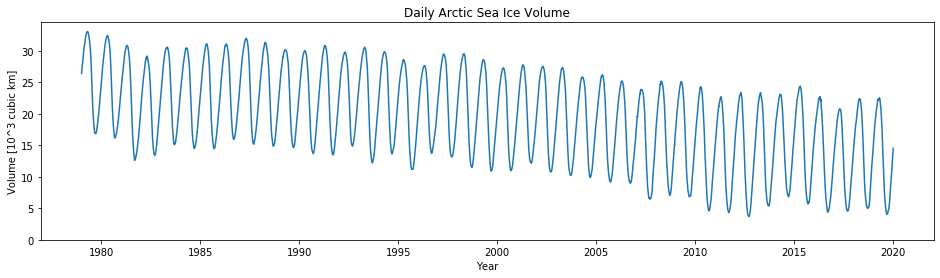

In [15]:
# plot volume time series
title = "Daily Arctic Sea Ice Volume"
plot_time_series(arctic_sea_ice_df, "Volume", units, title, ylim_min=0)

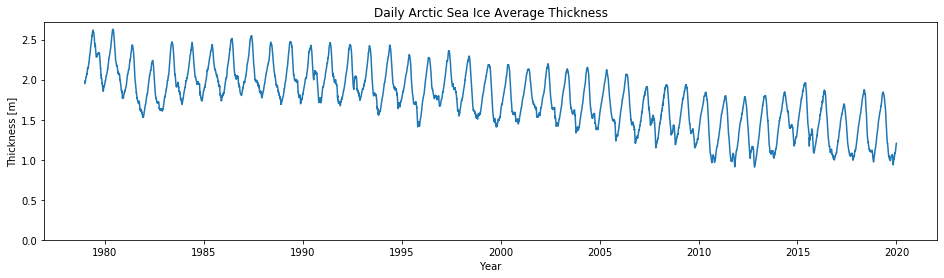

In [16]:
# plot thickness time series
title = "Daily Arctic Sea Ice Average Thickness"
plot_time_series(arctic_sea_ice_df, "Thickness", units, title, ylim_min=0)

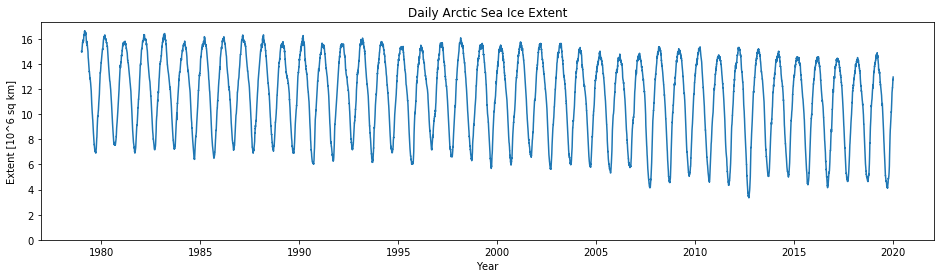

In [17]:
# plot extent time series
title = "Daily Arctic Sea Ice Extent"
plot_time_series(arctic_sea_ice_df, "Extent", units, title, ylim_min=0)

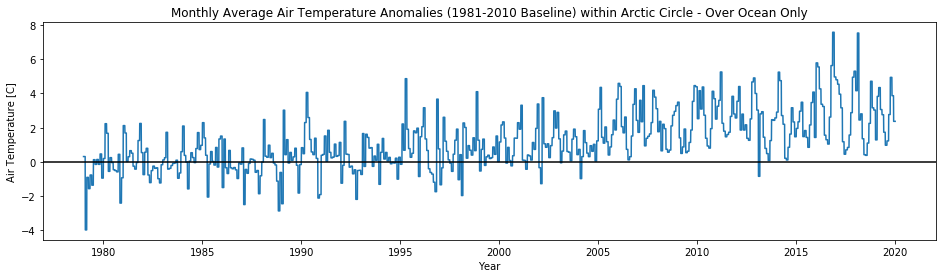

In [18]:
# plot air temperature time series
title = "Monthly Average Air Temperature Anomalies (1981-2010 Baseline) within Arctic Circle - Over Ocean Only"
plot_time_series(arctic_sea_ice_df, "Air Temperature", units, title, show_zero_line=True)

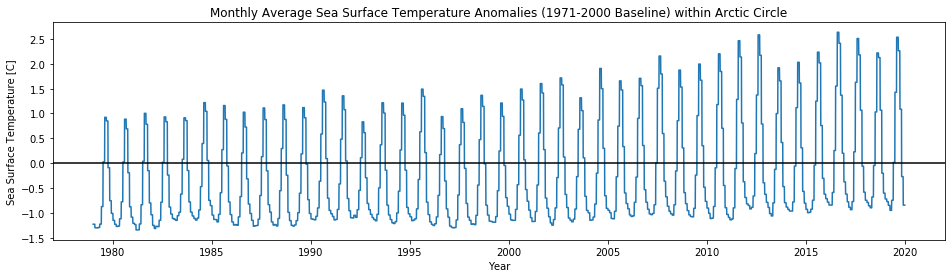

In [19]:
# plot sea surface temperature time series
title = "Monthly Average Sea Surface Temperature Anomalies (1971-2000 Baseline) within Arctic Circle"
plot_time_series(arctic_sea_ice_df, "Sea Surface Temperature", units, title, show_zero_line=True)

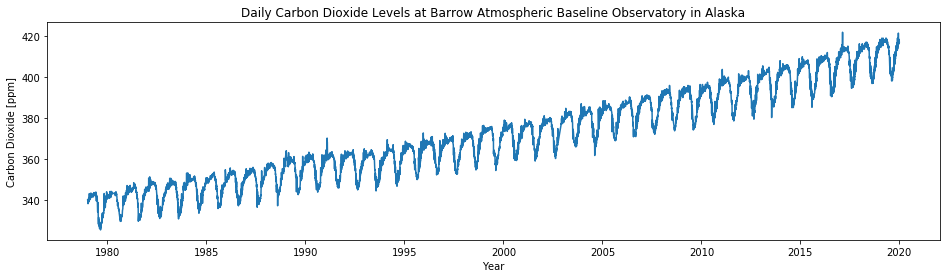

In [20]:
# plot carbon dioxide time series
title = "Daily Carbon Dioxide Levels at Barrow Atmospheric Baseline Observatory in Alaska"
plot_time_series(arctic_sea_ice_df, "Carbon Dioxide", units, title)

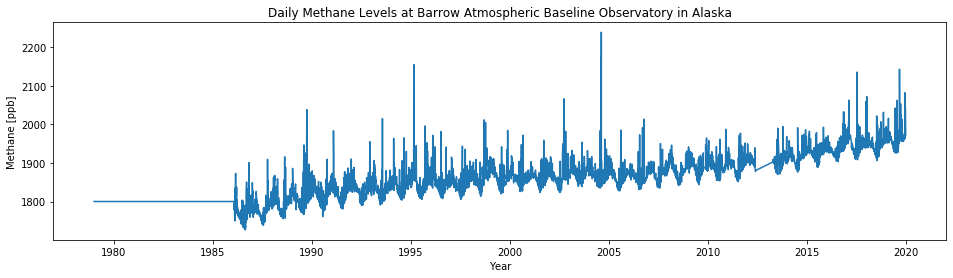

In [21]:
# plot methane time series
title = "Daily Methane Levels at Barrow Atmospheric Baseline Observatory in Alaska"
plot_time_series(arctic_sea_ice_df, "Methane", units, title)

The first thing of note after looking at these plots is that all the data looks cyclical with the period of one year, which is what we would expect.  It is known that the Arctic Sea Ice increases from September to March, and decreases from March to September.  We can also see that the temperatures, most notably the sea surface temperature has the same yearly cycle. This makes sense since we would expect the temperatures to increase during the summer and decrease during the winter.  We can even see cycles in the carbon dioxide and methane.  This is because in the spring and summer times, carbon dioxide is absorbed by plants and the levels decrease.  In the methane data, we can see more clearly the results of us imputing the data.  There is a flat line initially until the data begins.  There is also the gap of about a year in 2012-2013 filled in by a line.  We will be aware of this as we continue analysis.

The other thing to observe from these graphs is that aside from the cycles in the data, many features either show a trend down or a trend up.  The most notable of the downward trends is the Arctic Sea Ice volume.  It also seems that over time, there has been a decrease in average ice thickness and a slight decrease in extent.  When it comes to temperatures and greenhouse gases though, it is the opposite.  We can see that over time, that greenhouse gas levels have increased, most notably the carbon dioxide.  The methane shows a slight increase, more especially within the last five years.

In order to better understand these upward and downward trends, we can make a graph where we overlay each year on top of each other.  To do this, it will be helpful to have a month column in our Arctic Sea Ice dataframe that represents the months in a continuous data format.  We will do this by normalizing the amount of days in a month to give a unique value for each day of the year.  In other words, January 1st will have the value 1.0, January 2nd will have the value 1.032258, January 3rd 1.064516, etc. and February 1st will have the value 2.0, etc.

In [22]:
# continuous_month_value() will determine the continuous month value given the year, month, and day of month
def continuous_month_value(year, month, day):
    # determine normal from total number of days in a month
    norm = 1 / days_in_month(month, year)
    # determine the continuous month value for a given day of the month
    return ((day - 1) * norm) + month

# continuous_month_builder() will build a continuous month column given the arctic sea ice dataframe
def continuous_month_builder(df):
    days = list(df["Day"])
    months = list(df["Month"])
    years = list(df["Year"])
    continuous_months = []
    # for each date, calculate the continuous month value
    for date in range(0, len(months)):
        continuous_months.append(continuous_month_value(years[date], months[date], days[date]))
    return continuous_months

# set the continuous month column
arctic_sea_ice_df["Continuous Month"] = continuous_month_builder(arctic_sea_ice_df)

In [23]:
# plot_overlaying_years() will plot each year of a specified feature on the same graph, with an x-axis from 
# Janurary to December.  Parameters are provided to set the title, to control the range of the y-axis minimum, 
# to show a line at the y=0 mark, and/or to change the color palette of the seaborn plot
def plot_overlaying_years(df, feature, units, title, ylim_min=None, show_zero_line=False, color_palette="RdBu_r"):
    # use x-axis of "Month" if the y-axis data is monthly data
    if feature == "Air Temperature" or feature == "Sea Surface Temperature":
        x_feature = "Month"
    # use x-axis of "Continuous Month" if the y-axis data is daily data
    else:
        x_feature = "Continuous Month"
    # create line plot of feature vs month for each year
    plt.figure(figsize=(24, 12))
    plot = sns.lineplot(x=arctic_sea_ice_df[x_feature], y=arctic_sea_ice_df[feature], 
                        hue=arctic_sea_ice_df["Year"].astype("category"), sort=False, palette=color_palette)
    # put month name on x-axis ticks
    plot.set(xticklabels=["", "February", "April", "June", "August", "October", "December"])
    plt.xticks(rotation=45, ha="right")
    # for anomaly data, a line at the y=0 mark will be nice
    if show_zero_line:
        plot.axhline(0, color="black")
    # for data that shows decreases, set ylim to zero for clear understanding of data
    plt.ylim(ylim_min, None)
    plt.xlim(1, None)
    plt.xlabel("Month")
    # grab the right units for the y-axis label
    y_label = feature + " " + units[feature]
    plt.ylabel(y_label)
    plt.title(title)
    plt.show

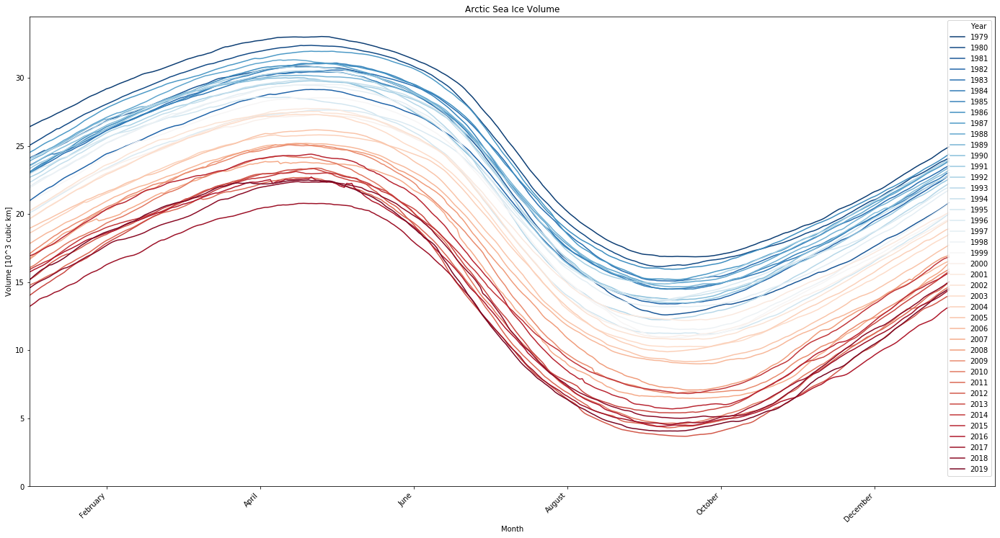

In [24]:
# plot overlaying years for volume
title = "Arctic Sea Ice Volume"
plot_overlaying_years(arctic_sea_ice_df, "Volume", units, title, ylim_min=0)

This plot makes it more clear the general trend of the Arctic Sea Ice volume.  There has been a steady decrease of Arctic Sea Ice since 1979.  In fact, let's quickly (*a retrospective voice from the future is heard laughing*) analyze the minimum and the maximum volume of each year, and see what the difference is between the highest and lowest maximum, as well as the difference between the highest and lowest minimum.

In [25]:
# analyze_min_and_max_of() will take a dataframe and a feature, and determine the minimum and maximum of each year.
# It will then make a plot of both the minimums and maximums, and well as print out which years had the highest and
# lowest values as well as the difference of the values, for both maximums and minimums
def analyze_min_and_max_of(df, feature, units, ylim_min=None):
    # build a min_max_df of year, minimums, and maximums for the given feature
    min_year = df["Year"].min()
    max_year = df["Year"].max()
    year_column = []
    min_column = []
    max_column = []
    for year in range(min_year, max_year+1):
        year_column.append(year);
        min_column.append(df[df["Year"] == year][feature].min())
        max_column.append(df[df["Year"] == year][feature].max())
    min_max_df = pd.DataFrame(zip(year_column, min_column, max_column))
    min_max_df.columns = ["Year", "Minimum", "Maximum"]
    # show both a reg and line plot for minimums and maximums
    plt.figure(figsize=(16, 8))
    sns.regplot(x="Year", y="Maximum", data=min_max_df)
    sns.regplot(x="Year", y="Minimum", data=min_max_df)
    sns.lineplot(x="Year", y="Maximum", data=min_max_df)
    sns.lineplot(x="Year", y="Minimum", data=min_max_df)
    plt.legend(labels=["Maxiumum", "Minimum"])
    plt.xlim(min_year)
    plt.ylim(ylim_min, None)
    plt.xlabel("Year")
    plt.ylabel(feature + " " + units[feature])
    plt.title("Yearly {} Maximum and Minimum".format(feature))
    plt.show()
    # calculate the differences of the highest and lowest maximums and of the highest and lowest minimums
    min_of_min = min_max_df["Minimum"].min()
    max_of_min = min_max_df["Minimum"].max()
    min_of_max = min_max_df["Maximum"].min()
    max_of_max = min_max_df["Maximum"].max()
    diff_in_min = abs(round(min_of_min - max_of_min, 3))
    diff_in_max = abs(round(min_of_max - max_of_max, 3))
    # determine which years these four events happened
    min_of_min_year = min_max_df["Year"][min_max_df[min_max_df["Minimum"] == min_of_min].index].values[0]
    max_of_min_year = min_max_df["Year"][min_max_df[min_max_df["Minimum"] == max_of_min].index].values[0]
    min_of_max_year = min_max_df["Year"][min_max_df[min_max_df["Maximum"] == min_of_max].index].values[0]
    max_of_max_year = min_max_df["Year"][min_max_df[min_max_df["Maximum"] == max_of_max].index].values[0]
    # print out report
    print("Yearly {} Maximums: Highest in {} with {:.5} {} and Lowest in {} with {:.5} {}".format(feature, 
          max_of_max_year, max_of_max, units[feature], min_of_max_year, min_of_max, units[feature]))
    print("Yearly {} Minimums: Highest in {} with {:.5} {} and Lowest in {} with {:.5} {} \n".format(feature, 
          max_of_min_year, max_of_min, units[feature], min_of_min_year, min_of_min, units[feature]))
    print("Yearly {} Maximums Highest and Lowest Difference: {} {}".format(feature, diff_in_max, units[feature]))
    print("Yearly {} Minimums Highest and Lowest Difference: {} {} \n".format(feature, diff_in_min, units[feature]))

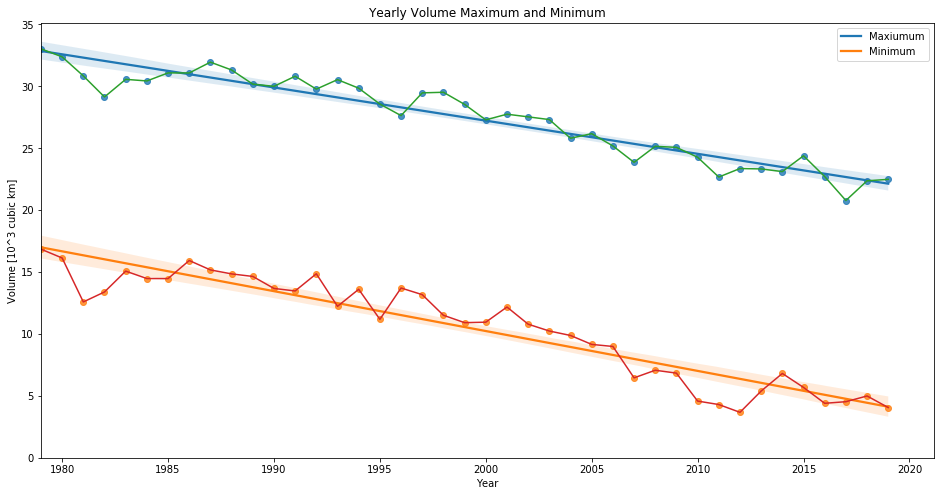

Yearly Volume Maximums: Highest in 1979 with 33.035 [10^3 cubic km] and Lowest in 2017 with 20.782 [10^3 cubic km]
Yearly Volume Minimums: Highest in 1979 with 16.855 [10^3 cubic km] and Lowest in 2012 with 3.673 [10^3 cubic km] 

Yearly Volume Maximums Highest and Lowest Difference: 12.253 [10^3 cubic km]
Yearly Volume Minimums Highest and Lowest Difference: 13.182 [10^3 cubic km] 



In [26]:
# analyze min and max of volume
analyze_min_and_max_of(arctic_sea_ice_df, "Volume", units, ylim_min=0)

From  this analysis, we can see that both the maximums and minimums have been declining at almost the same rate.  The lowest volume the Arctic Sea Ice has ever had was in 2012 and the lowest yearly maximum volume was in 2017.  In fact, it looks like at the current rate, that the yearly volume minimums will hit zero in the next few decades if we assume a linear decline. We will analyze this later, but for now, let's continue taking a look at the other features of the Arctic Sea Ice.  Let's take a look at how thick the ice is next.

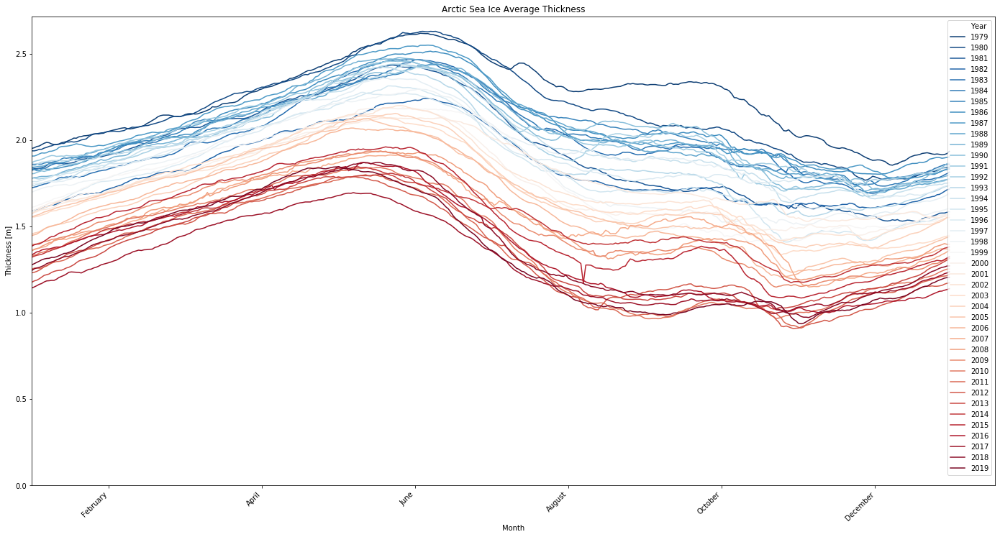

In [27]:
# plot overlaying years for thickness
title = "Arctic Sea Ice Average Thickness"
plot_overlaying_years(arctic_sea_ice_df, "Thickness", units, title, ylim_min=0)

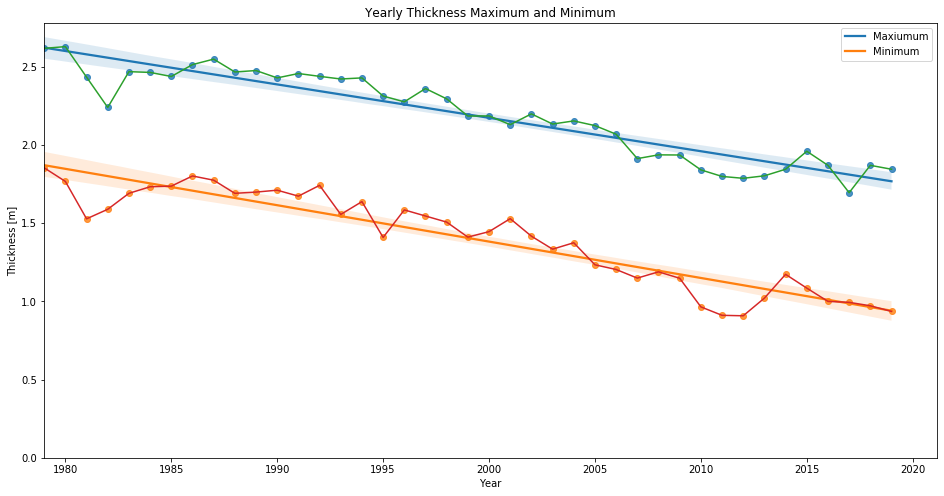

Yearly Thickness Maximums: Highest in 1980 with 2.629 [m] and Lowest in 2017 with 1.695 [m]
Yearly Thickness Minimums: Highest in 1979 with 1.854 [m] and Lowest in 2012 with 0.908 [m] 

Yearly Thickness Maximums Highest and Lowest Difference: 0.934 [m]
Yearly Thickness Minimums Highest and Lowest Difference: 0.946 [m] 



In [28]:
# analyze min and max of thickness
analyze_min_and_max_of(arctic_sea_ice_df, "Thickness", units, ylim_min=0)

The average Arctic Sea Ice thickness has been in decline which is what we would expect since the volume is declining.  We can see that the lowest of the thickness maximums and minimums was in 2017 and 2012 respectively.  This agrees well with the volume data, since volume is dependent on how thick the ice is. The maximums and minimums of the thickness of the ice are both declining at about the same rate as well.  It is interesting to note that the thickness continues to grow in April when the volume starts decreasing.  Let's look at the extent of the ice now.

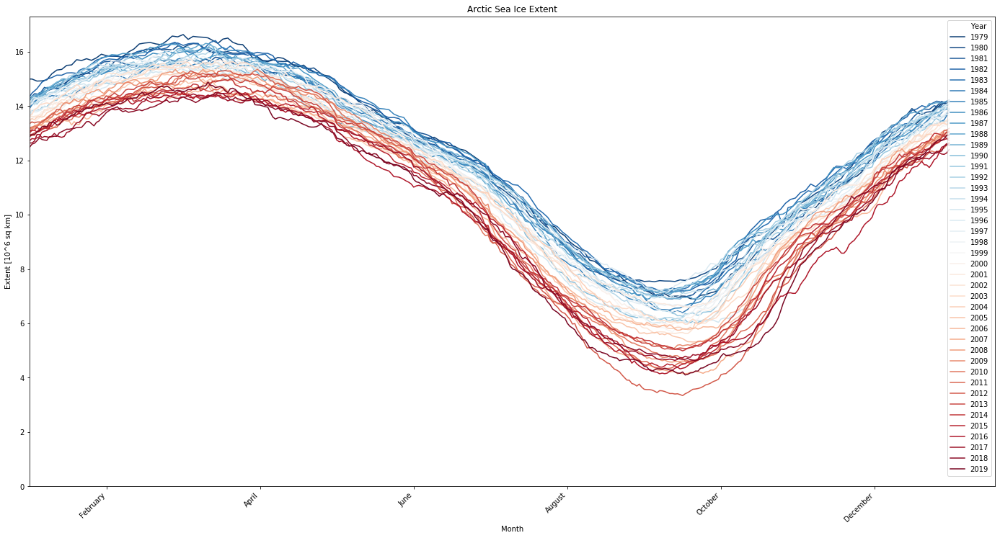

In [29]:
# plot overlaying years for extent
title = "Arctic Sea Ice Extent"
plot_overlaying_years(arctic_sea_ice_df, "Extent", units, title, ylim_min=0)

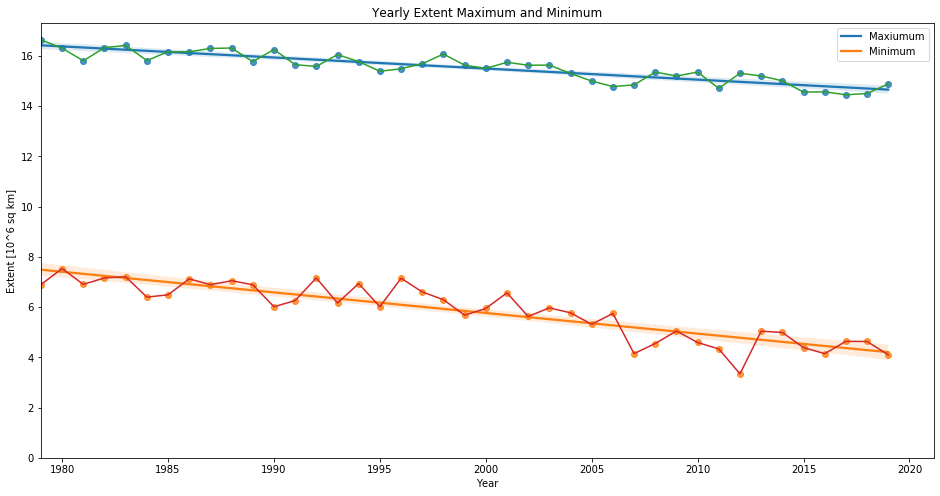

Yearly Extent Maximums: Highest in 1979 with 16.635 [10^6 sq km] and Lowest in 2017 with 14.449 [10^6 sq km]
Yearly Extent Minimums: Highest in 1980 with 7.533 [10^6 sq km] and Lowest in 2012 with 3.34 [10^6 sq km] 

Yearly Extent Maximums Highest and Lowest Difference: 2.186 [10^6 sq km]
Yearly Extent Minimums Highest and Lowest Difference: 4.193 [10^6 sq km] 



In [30]:
# analyze min and max of extent
analyze_min_and_max_of(arctic_sea_ice_df, "Extent", units, ylim_min=0)

The Arctic Sea Ice extent also shows decline which is also what we would expect given the volume decline.  Once again, we can see that the lowest maximum and minimum extent were in 2017 and 2012 respectively.  Again, the rate of decline seems more or less the same.  Another thing to note is that it appears that in 2012, the Arctic Sea Ice took a much more noticable dip than any other year.  So overall we can see that 2012 was the lowest year for Arctic Sea Ice in volume, thickness, and extent.  Let's take a look at the air temperature now.

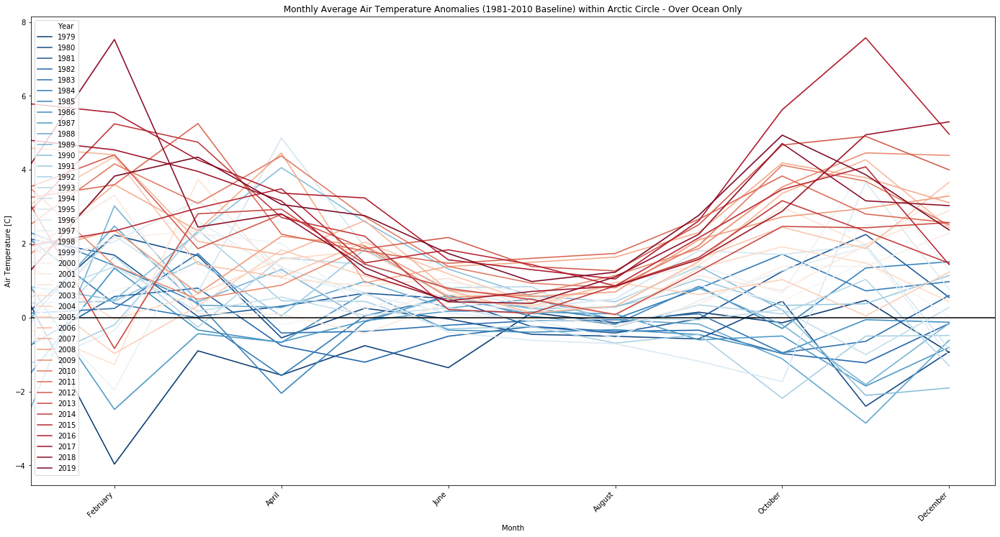

In [31]:
# plot overlaying years for air temperature
title = "Monthly Average Air Temperature Anomalies (1981-2010 Baseline) within Arctic Circle - Over Ocean Only"
plot_overlaying_years(arctic_sea_ice_df, "Air Temperature", units, title, show_zero_line=True)

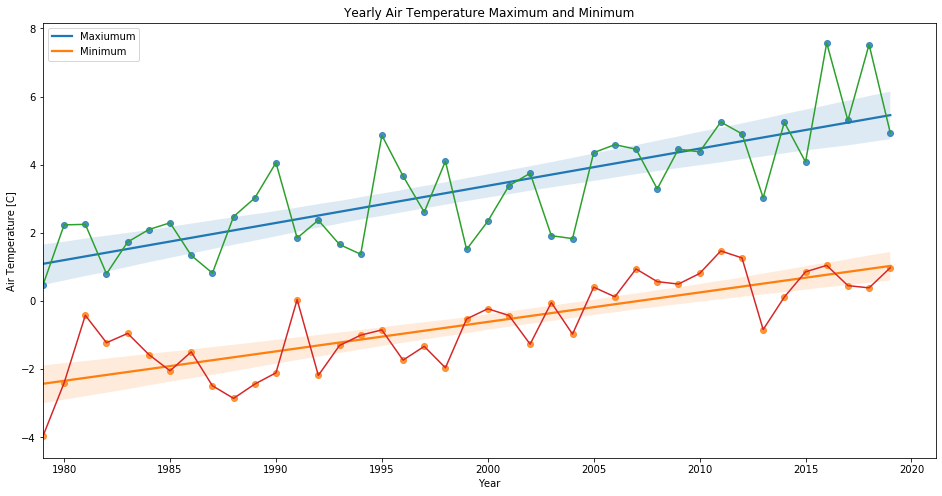

Yearly Air Temperature Maximums: Highest in 2016 with 7.574 [C] and Lowest in 1979 with 0.467 [C]
Yearly Air Temperature Minimums: Highest in 2011 with 1.47 [C] and Lowest in 1979 with -3.967 [C] 

Yearly Air Temperature Maximums Highest and Lowest Difference: 7.107 [C]
Yearly Air Temperature Minimums Highest and Lowest Difference: 5.437 [C] 



In [32]:
# analyze min and max of air temperature
analyze_min_and_max_of(arctic_sea_ice_df, "Air Temperature", units)

The air temperature is interesting.  From overlaying the years on top of each other, we can see that the highest and lowest air temperature anomalies occur in the coldest times of the year, and that the anomaly differences flatten during the hottest times of the year.  From this we can see that the Arctic Air has been having hotter than normal days during the winter, and more so in recent years.  We can also see that both the yearly minimums and maximums are increasing.  This agrees with the fact that Arctic Sea Ice is declining.  In fact, the relationship between rise in temperature, and how much energy an object absorbs is linear.  Here is a quick simple explanation of the physics of heat transfer and temperature change:

https://sciencing.com/calculate-change-temperature-2696.html

It would be interesting to attempt a linear regression model to predict Arctic Sea Ice volume using just our temperature data.  We will do that later, but for now let's look at sea surface tempertaure.

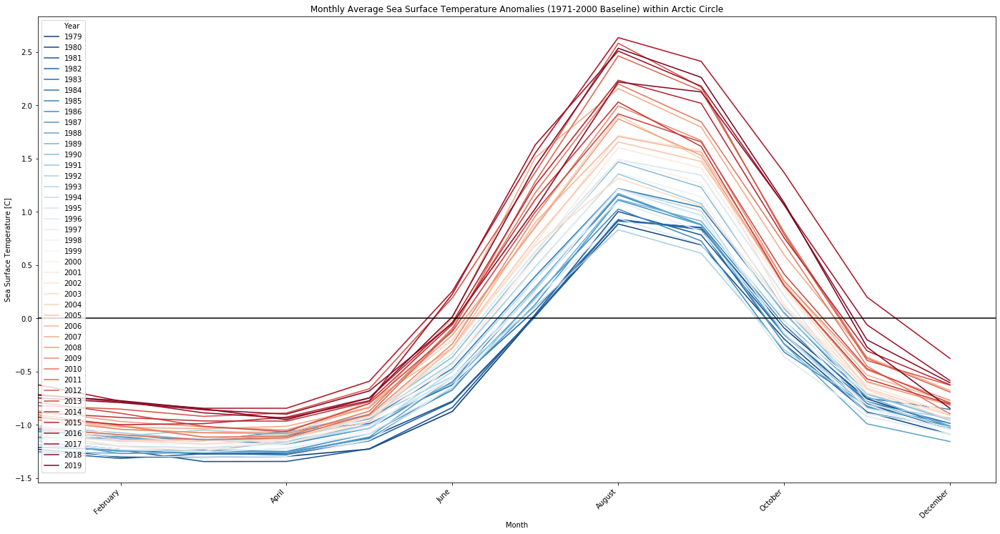

In [33]:
# plot overlaying years for sea surface temperature
title = "Monthly Average Sea Surface Temperature Anomalies (1971-2000 Baseline) within Arctic Circle"
plot_overlaying_years(arctic_sea_ice_df, "Sea Surface Temperature", units, title, show_zero_line=True)

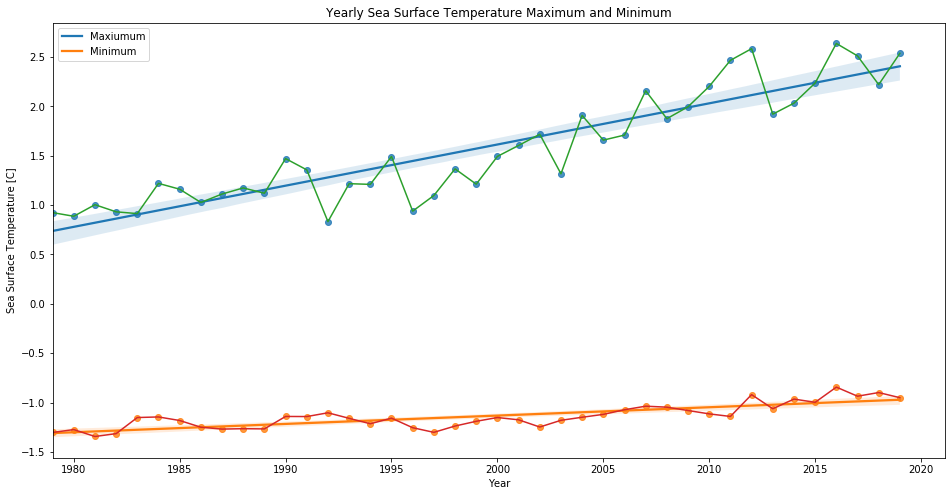

Yearly Sea Surface Temperature Maximums: Highest in 2016 with 2.636 [C] and Lowest in 1992 with 0.832 [C]
Yearly Sea Surface Temperature Minimums: Highest in 2016 with -0.844 [C] and Lowest in 1981 with -1.344 [C] 

Yearly Sea Surface Temperature Maximums Highest and Lowest Difference: 1.804 [C]
Yearly Sea Surface Temperature Minimums Highest and Lowest Difference: 0.5 [C] 



In [34]:
# analyze min and max of sea surface temperature
analyze_min_and_max_of(arctic_sea_ice_df, "Sea Surface Temperature", units)

From the overlapping years graph, we can see that the surface of the Arctic Ocean is getting hotter, and is having hotter than normal days especially at the end of summer.  This agrees well with our ice data since we know that the ice reaches its minimum at the end of summer in September.  What else is interesting is that the yearly maximums and minimums are not increasing at the same rate.  The yearly minimums are barely increasing.  It's the yearly maximums that are increasing at a much higher rate.  This may make sense given what we know about latent heat:

http://hyperphysics.phy-astr.gsu.edu/hbase/thermo/phase.html

When ice is melting into water, and when water is freezing into ice, it's temperature is zero degrees Celsius.  The temperature doesn't increase or decrease until the phase of the element has changed.  So it may be that in the summer time when there is more water than ice, that the monthly average anomaly tends to be greater than in the winter time, because the water can finally increase in temperature after being melted.  This is just a hypothesis for why the data looks the way it does, and with just monthly averages, we can't get a full picture of the temperature of the surface of the Arctic Ocean.  We would instead need spatial data instead of overall averages.  Let's take a look now at carbon dioxide.

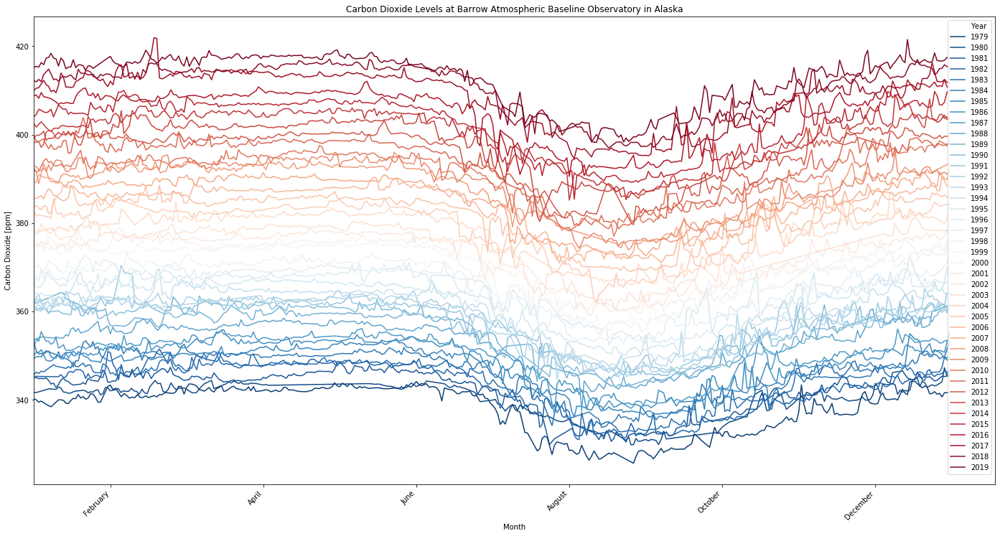

In [35]:
# plot overlaying years for carbon dioxide
title = "Carbon Dioxide Levels at Barrow Atmospheric Baseline Observatory in Alaska"
plot_overlaying_years(arctic_sea_ice_df, "Carbon Dioxide", units, title)

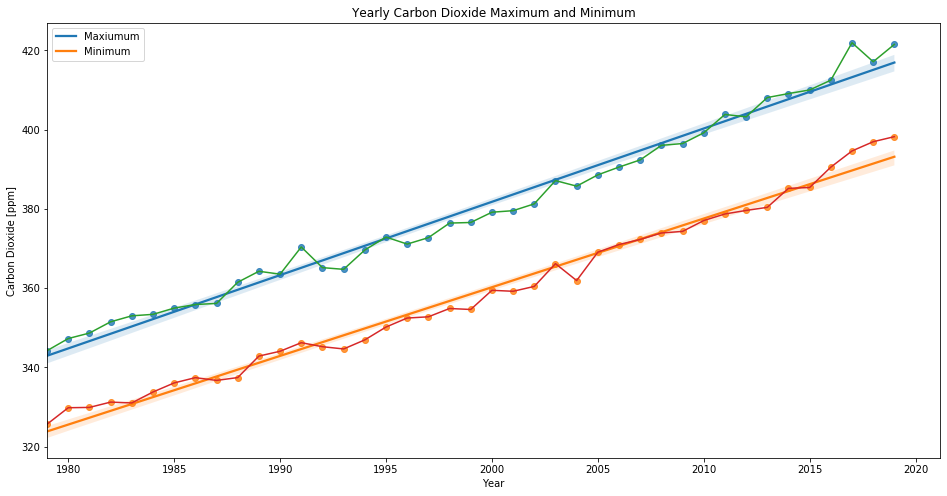

Yearly Carbon Dioxide Maximums: Highest in 2017 with 421.91 [ppm] and Lowest in 1979 with 344.21 [ppm]
Yearly Carbon Dioxide Minimums: Highest in 2019 with 398.21 [ppm] and Lowest in 1979 with 325.66 [ppm] 

Yearly Carbon Dioxide Maximums Highest and Lowest Difference: 77.7 [ppm]
Yearly Carbon Dioxide Minimums Highest and Lowest Difference: 72.55 [ppm] 



In [36]:
# analyze min and max of carbon dioxide
analyze_min_and_max_of(arctic_sea_ice_df, "Carbon Dioxide", units)

From both these graphs, we can see that carbon dioxide levels have been increasing steadily over the years in the Arctic Circle (assuming the Barrow Atmospheric Baseline Observation measurements roughtly estimate the rest of the Arctic).  Both the yearly maximums and yearly minimums have been increasing at the same rate.  From the printed report, there has been about a 75 parts per million increase in carbon dioxide levels within the last 40 years.  We know that the concentration levels of carbon dioxide increase the temperature logarithmically.  Here is an explanation that goes more into the physics of why and how it affects polar amplification (increased rate of warming compared to lower latitudes):

http://nicklutsko.github.io/blog/2018/08/26/Why-CO2-Forcing-Is-Logarithmic

It would be interesting to build a linear regression model predicting volume using just greenhouse gases, carbon dioxide and methane.  We should expect a poorer model than one that uses just temperature data due to the non-linearity of greenhouse gas concentrations to change in temperature, remembering that change in temperature is linear to the change in volume.  We will analyze this later, but not before we take a look at methane.

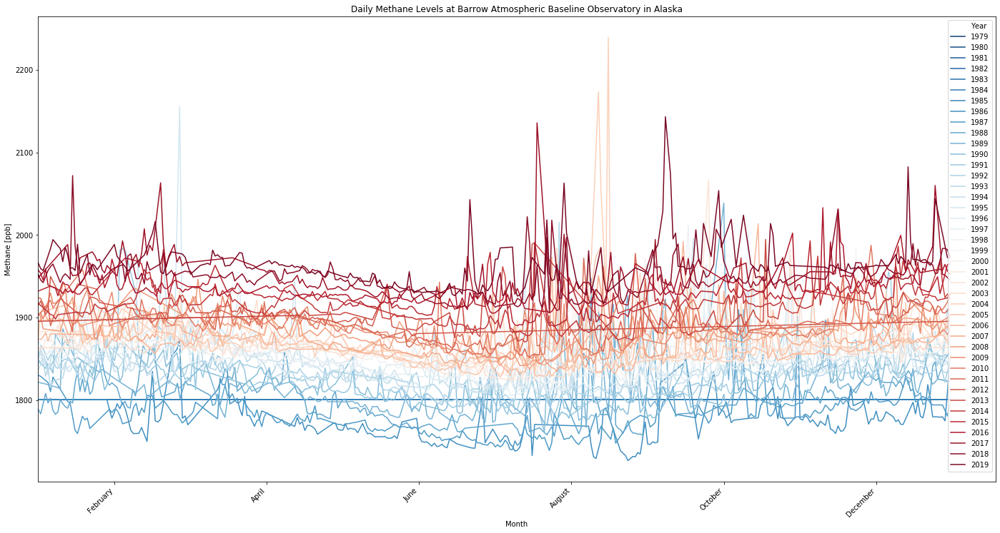

In [37]:
# plot overlaying years for methane
title = "Daily Methane Levels at Barrow Atmospheric Baseline Observatory in Alaska"
plot_overlaying_years(arctic_sea_ice_df, "Methane", units, title)

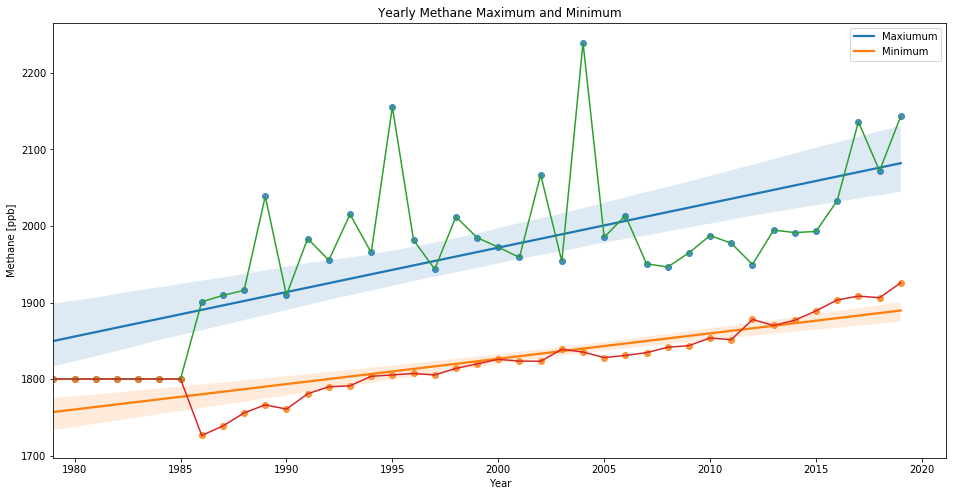

Yearly Methane Maximums: Highest in 2004 with 2239.3 [ppb] and Lowest in 1979 with 1800.2 [ppb]
Yearly Methane Minimums: Highest in 2019 with 1925.9 [ppb] and Lowest in 1986 with 1726.5 [ppb] 

Yearly Methane Maximums Highest and Lowest Difference: 439.03 [ppb]
Yearly Methane Minimums Highest and Lowest Difference: 199.31 [ppb] 



In [38]:
# analyze min and max of methane
analyze_min_and_max_of(arctic_sea_ice_df, "Methane", units)

Acknowledging that this data is incorrect before 1986, we can see that methane levels have also been rising.  It is curious that some years have high spikes in methane.  This could be for various reasons:

https://en.wikipedia.org/wiki/Arctic_methane_emissions

Some reasons may be melting permafrost, or methane clathrates at the bottom of the shallow Arctic Ocean floor that can melt when there is no ice cover.  Now that we have taken a closer look at all the data features, it would be interesting to see the correlations (remembering that correlation is not causation) between the different data features. Let's make some scatter plots so that we can visually see how these different data features map with each other, and to see the positive or negative correlations.  First, let's compare volume, thickness, and extent with each other.

In [39]:
# create_scatter_plot() will take a x axis feature, and a y axis feature, and create a scatter plot.  Parameters are
# provided to pass in the units dictionary object, title of the plot, a x and y axis minimum setting, and a color
# palette
def create_scatter_plot(df, x_feature, y_feature, units, title, xlim_min=None, ylim_min=None, color_palette="RdBu_r"):
    plt.figure(figsize=(24, 12))
    # show gradient on the years
    sns.scatterplot(x=x_feature, y=y_feature, hue=df["Year"].astype("category"), data=df, palette=color_palette)
    plt.xlim(xlim_min, None)
    plt.ylim(ylim_min, None)
    # put units into x and y axis labels
    plt.xlabel(x_feature + " " + units[x_feature])
    plt.ylabel(y_feature + " " + units[y_feature])
    plt.title(title)
    plt.show()

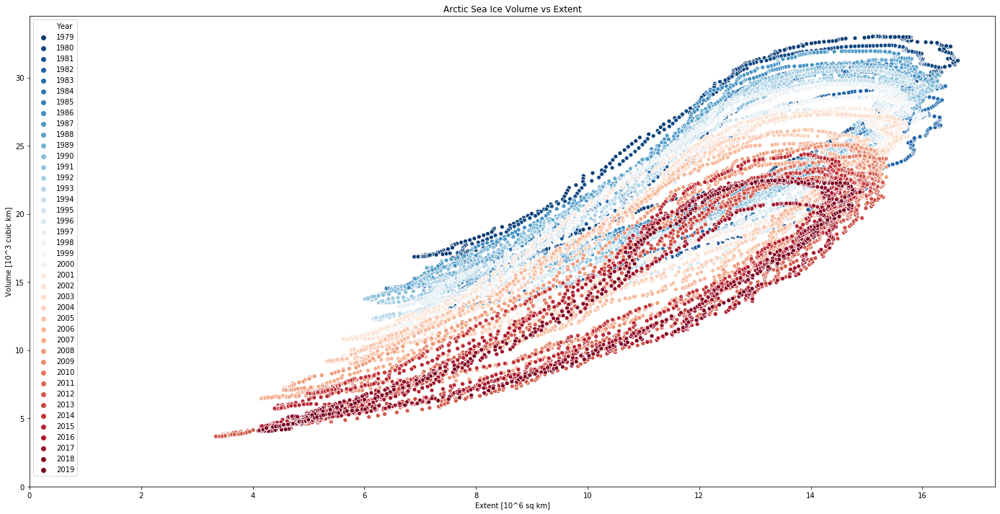

In [40]:
# make scatter plot of volume vs extent
title="Arctic Sea Ice Volume vs Extent"
create_scatter_plot(arctic_sea_ice_df, "Extent", "Volume", units, title, xlim_min=0, ylim_min=0)

It is interesting to see the oscillations in the above graph and the general shift of it over time.

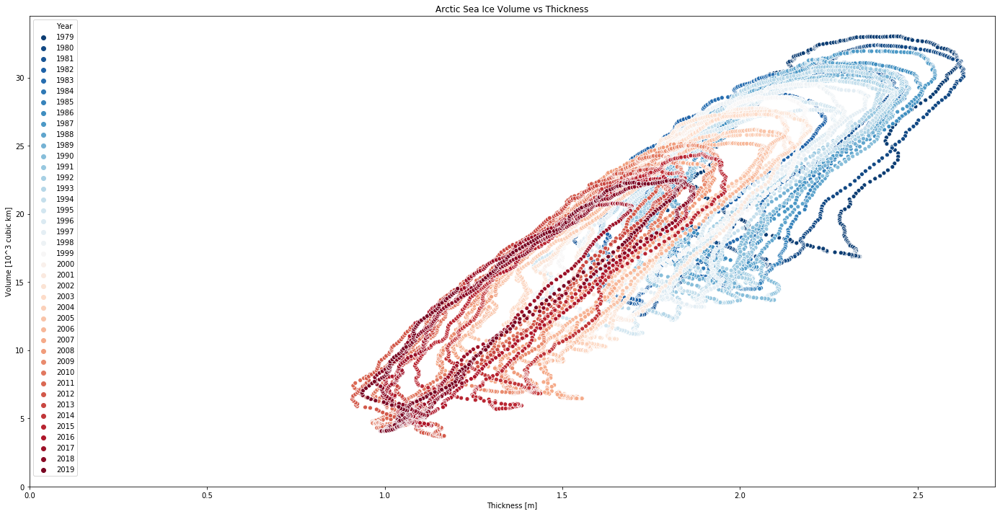

In [41]:
# make scatter plot of volume vs thickness
title="Arctic Sea Ice Volume vs Thickness"
create_scatter_plot(arctic_sea_ice_df, "Thickness", "Volume", units, title, xlim_min=0, ylim_min=0)

Once again we can see a shape of the yearly oscillations shifting.

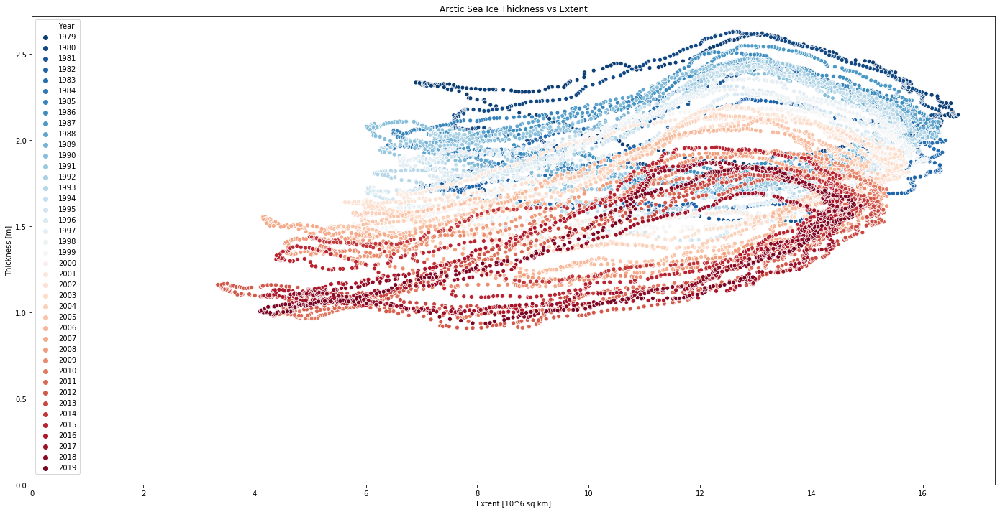

In [42]:
# make scatter plot of thickness vs extent
title="Arctic Sea Ice Thickness vs Extent"
create_scatter_plot(arctic_sea_ice_df, "Extent", "Thickness", units, title, xlim_min=0, ylim_min=0)

Now let's compare volume with greenhouse gas levels

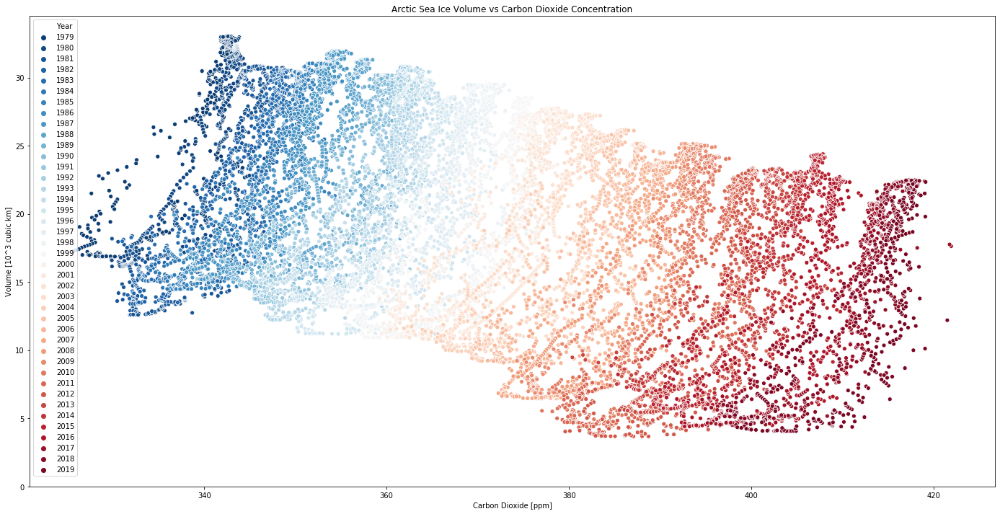

In [43]:
# make scatter plot of volume vs carbon dioxide
title="Arctic Sea Ice Volume vs Carbon Dioxide Concentration"
create_scatter_plot(arctic_sea_ice_df, "Carbon Dioxide", "Volume", units, title, ylim_min=0)

There is a negative correlation between volume and carbon dioxide concentration.

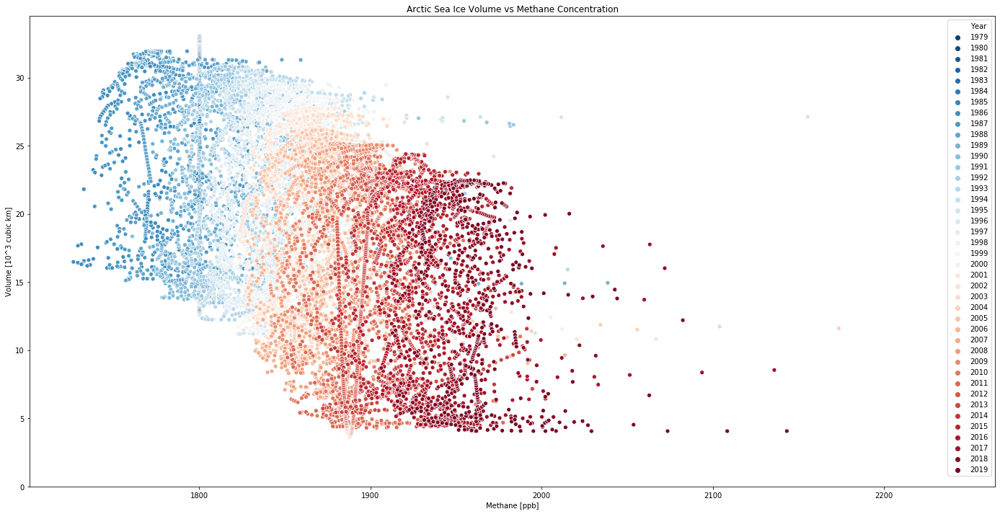

In [44]:
# make scatter plot of volume vs methane
title="Arctic Sea Ice Volume vs Methane Concentration"
create_scatter_plot(arctic_sea_ice_df, "Methane", "Volume", units, title, ylim_min=0)

There is also a negative correlation between volume and methane concentration.  It would be interesting now to do a scatterplot of Arctic Sea Ice extent with air temperatures and sea surface temperatures.  These next two scatter plots don't look as smooth since the extent values are daily, but the temperature values are monthly, but let's take a look anyways.

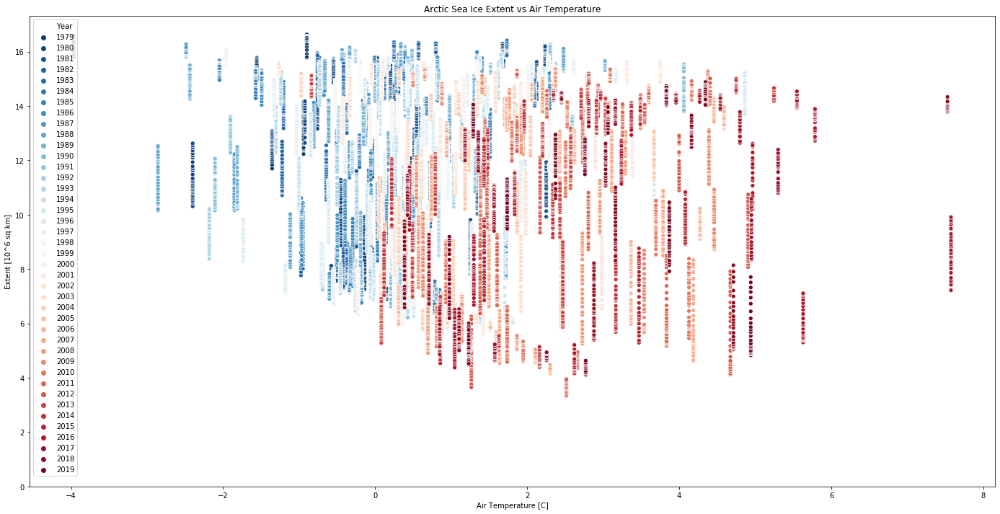

In [45]:
# make scatter plot of extent vs air temperature
title="Arctic Sea Ice Extent vs Air Temperature"
create_scatter_plot(arctic_sea_ice_df, "Air Temperature", "Extent", units, title, ylim_min=0)

We can see that there is a negative correlation between extent and air temperature.

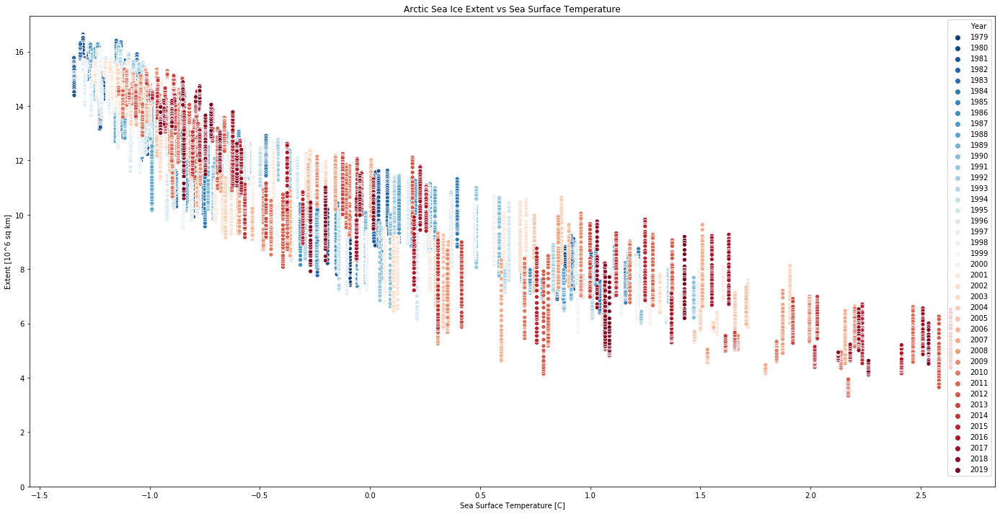

In [46]:
# make scatter plot of extent vs sea surface temperature
title="Arctic Sea Ice Extent vs Sea Surface Temperature"
create_scatter_plot(arctic_sea_ice_df, "Sea Surface Temperature", "Extent", units, title, ylim_min=0)

I found this plot intriguing.  We can see that there is a certain oscillation in the extent vs the sea surface temperatures.  That is why we can see past years (the blue) and recent years (the red) all along the same oscillation path.  The only thing to note is that in recent years, the lower right part of the oscillation is moving much further to the right due to higher than normal sea surface temperatures in the summer.

Before we were talking about how an increase in greenhouse gas concentrations is logarithmically proportional to increase in temperature.  Let's make a scatter plot of air temperatures vs carbon dioxide levels.

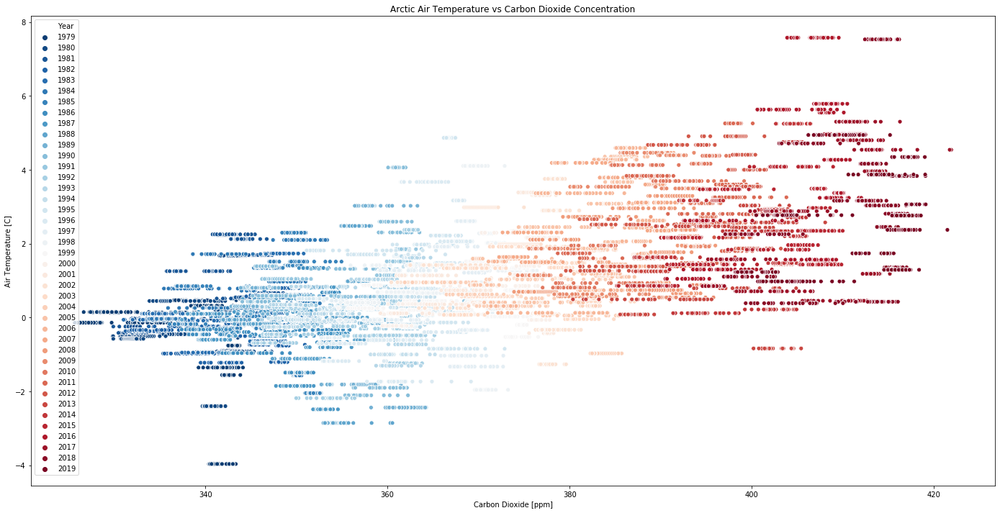

In [47]:
# make scatter plot of volume vs extent
title="Arctic Air Temperature vs Carbon Dioxide Concentration"
create_scatter_plot(arctic_sea_ice_df, "Carbon Dioxide", "Air Temperature", units, title)

Let's just make one more scatter plot, and then we'll start moving forwards with machine learning.

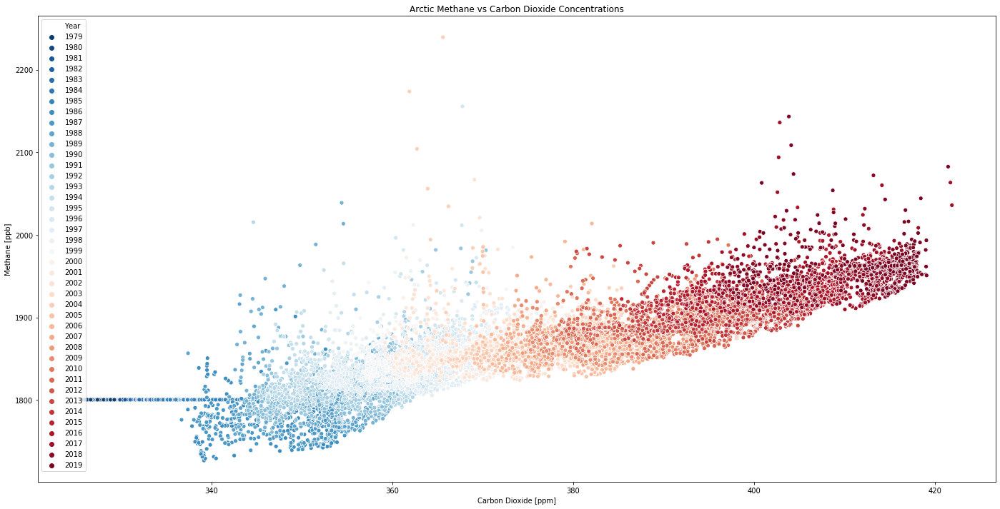

In [48]:
# make scatter plot of methane vs carbon dioxide
title="Arctic Methane vs Carbon Dioxide Concentrations"
create_scatter_plot(arctic_sea_ice_df, "Carbon Dioxide", "Methane", units, title)

There have been a few ideas we've mentioned above that we said we would later analyze.  Let's gather those ideas here:

First, we want to analyze when the Arctic Sea Ice volume will reach zero.  The following is a recent study talking about this subject:

https://agupubs.onlinelibrary.wiley.com/doi/abs/10.1029/2019GL086749

In this study, they estimate that sea ice extent will reach less than one million kilometers squared by for the first time by 2050, which they call Sea Ice Free.

Second, we want to look at the relationship between change in temperature and rate of ice melt.

Third, we want to look at the relationship between greenhouse gases and rate of ice melt.

We can do all these things with machine learning.  So to start, let's make a machine learning model that will attempt to predict when the Arctic Sea Ice volume will reach zero.  To start our analysis of this, we will need to better understand what we mean by reaching zero.  It will be helpful to make a plot showing the minimum volume of each individual month throughout the years.

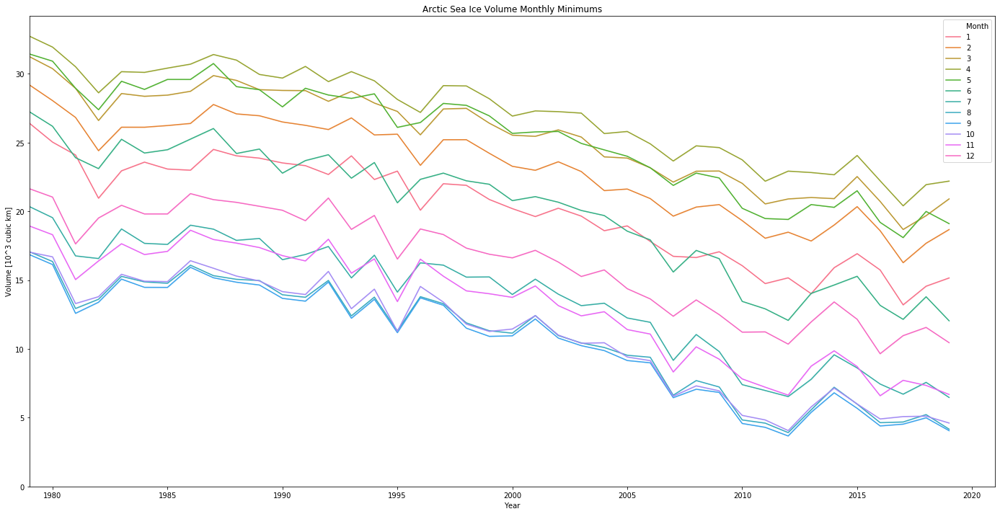

In [49]:
# plot_monthly_minimums will take a feature from df, and determine its minimum value every month.  It will then plot
# the values in each individual month over time. We only use this with volume, but it can be used with other features.
# It also returns the minimums from the month of September as a dataframe.
def plot_monthly_minimums(df, feature, units):
    # determine min for axis setting
    min_year = df["Year"].min()
    max_year = df["Year"].max()
    # prepare for scan
    month = 1
    month_index_start = 0
    column = feature + " " + units[feature]
    september_mins = []
    monthly_min_df = pd.DataFrame(index=range(len(df)))
    monthly_min_df[column] = 0
    # determine where beginning and end of month are and save the minimum value
    for index, row in df.iterrows():
        if row["Month"] != month:
            month_min = df[feature][month_index_start:index].min(axis=0)
            # keep track of and return september minimums
            if month == 9:
                september_mins.append(month_min)
            monthly_min_df[column][month_index_start:index] = month_min
            month = row["Month"]
            month_index_start = index
    # prepare september minimums for returning
    september_mins_df = pd.DataFrame(zip(range(min_year, max_year + 1), september_mins))
    september_mins_df.columns = ["Year", "Minimum"]
    # compute the last year's month's minimum value
    monthly_min_df[column][month_index_start:index+1] = df[feature][month_index_start:index+1].min(axis=0)
    # create line plot showing all the individual months
    plt.figure(figsize=(24, 12))
    sns.lineplot(x=df["Year"], y=monthly_min_df[column], hue=df["Month"].astype("category"), sort=False)
    plt.xlim(min_year, None)
    plt.ylim(0, None)
    plt.xlabel("Year")
    plt.ylabel("Volume {}".format(units[feature]))
    plt.title("Arctic Sea Ice Volume Monthly Minimums")
    plt.show()
    return september_mins_df
    
september_mins_df = plot_monthly_minimums(arctic_sea_ice_df, "Volume", units)

We can see from the above graph that the each individual month is declining in volume.  So that means that if the Arctic Sea Ice volume keeps on declining, it will reach a volume of zero depending on what month it is.  In other words, we'll want our machine learning model to predict which year each month will experience zero volume ice for the first time.  From the above graph, we can see that the month of September will most likely be the first month to hit zero volume.  Let's take a look at one last plot and then we can end data visualization and move on to machine learning.  Let's plot the minimum values of just September. Since the algorithm for this is the same as the above plot, we modified it so that it already returned the September minimums to us from the plot.

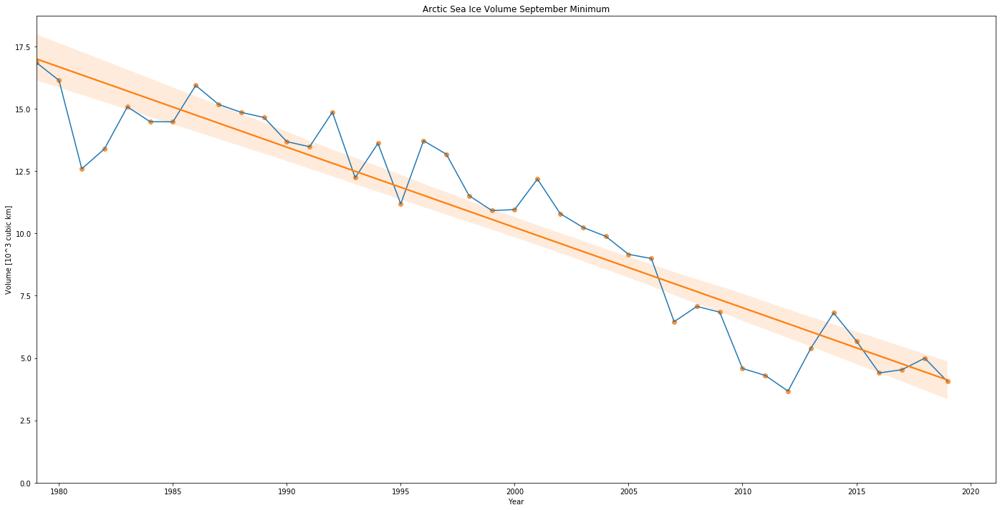

In [50]:
# plot the september minimums, which is the same as the minimum for each year
plt.figure(figsize=(24, 12))
# make both a line plot and regplot of September minimums
sns.lineplot(x="Year", y="Minimum", data=september_mins_df)
sns.regplot(x="Year", y="Minimum", data=september_mins_df)
plt.xlim(1979, None)
plt.ylim(0, None)
plt.xlabel("Year")
plt.ylabel("Volume {}".format(units["Volume"]))
plt.title("Arctic Sea Ice Volume September Minimum")
plt.show()

__Linear Regression__

There are many variables and factors that determine Arctic Sea Ice volume other than the data that we have here.  It may be that the downward trend is not linear, but will curve up and smooth out with time as it approaches zero.  However, for our purposes, let us assume a linear relationship between volume and time.  Let's start by building a linear regression machine learning model that estimates the volume with time.  We will later want to build other machine learning models in addition to this one, so it will be extremely helpful to build a function that can build a linear regression model, and store the results in a dataframe for later comparison.

The following article is helpful in learning linear regression with sklearn:
https://towardsdatascience.com/a-beginners-guide-to-linear-regression-in-python-with-scikit-learn-83a8f7ae2b4f

In [51]:
# create_and_evaluate_linear_regression_model() will build a linear regression model with the features and label
# specified in the parameters.  It will split the df up into training and test data sets. It will then predict create
# the model and use it to predict the labels from the test data.  It will also evaluate the model by computing three 
# different metrics for the error, and it will create a plot comparing the actual labels with the predicted
# labels.  Finally, it inserts data about the model into results_df and returns results_df
def create_and_evaluate_linear_regression_model(df, features, label, results_df, train_test_ratio=0.2):
    # Assumes results_df is already built
    if results_df is None:
        return
    # shuffle data
    df = df.sample(frac=1)
    # grab features and label
    X = df[features].values
    y = df[label].values
    # split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=train_test_ratio)
    # build linear regression model
    linear_regression_model = LinearRegression()  
    linear_regression_model = linear_regression_model.fit(X_train, y_train)
    # make label predictions with model
    y_pred = linear_regression_model.predict(X_test)
    # evaluate model error and print results
    mean_absolute_error = metrics.mean_absolute_error(y_test, y_pred)
    mean_squared_error = metrics.mean_squared_error(y_test, y_pred)
    root_mean_squared_error = np.sqrt(metrics.mean_squared_error(y_test, y_pred))
    print("Features: {}".format(features))
    print("Label: {} \n".format(label))
    print("Mean Absolute Error: {}".format(mean_absolute_error))
    print("Mean Squared Error: {}".format(mean_squared_error))
    print("Root Mean Squared Error: {}".format(root_mean_squared_error))
    # insert results into results_df
    results_df = results_df.append({"Features": features, 
                                    "Label": label,  
                                    "Linear Intercept": linear_regression_model.intercept_, 
                                    "Linear Coefficients": linear_regression_model.coef_, 
                                    "Mean Absolute Error": mean_absolute_error, 
                                    "Mean Squared Error": mean_squared_error, 
                                    "Root Mean Squared Error": root_mean_squared_error,}, ignore_index=True)
    # Make dataframe that compares actual labels with model predicted labels
    model_comparison_df = pd.DataFrame(zip(y_test, y_pred))
    model_comparison_df.columns = ["Actual", "Predicted"]
    # Plot the actual labels vs the predicted labels
    plt.figure(figsize=(8, 8))
    sns.scatterplot(x="Actual", y="Predicted", data=model_comparison_df)
    sns.lineplot(x=range(int(df[label].min()), int(df[label].max())), 
                 y=range(int(df[label].min()), int(df[label].max())), color="Red")
    if label == "Volume":
        plt.xlim(0, None)
        plt.ylim(0, None)
    plt.xlabel("Actual")
    plt.ylabel("Predicted")
    plt.title("Linear Regression Model Evaluation")
    plt.show()
    return results_df

Now that we have a function that makes building multiple linear regression models easier, let's start off with a model that simply uses the year and month as the features, and the volume for the label.

Features: ['Year', 'Month']
Label: Volume 

Mean Absolute Error: 3.840415231363908
Mean Squared Error: 19.20287133968441
Root Mean Squared Error: 4.382108093108203


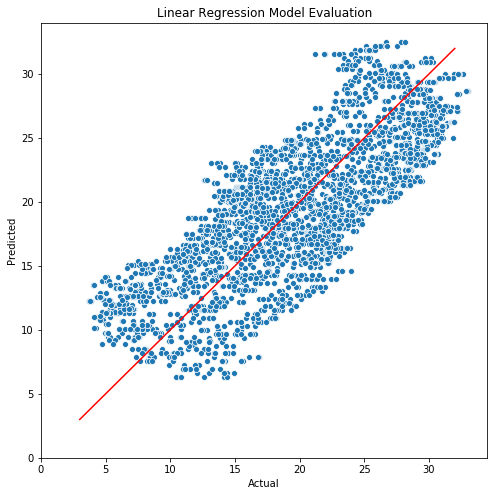

In [52]:
# initialize results dataframe
results_df = pd.DataFrame(columns=["Features", "Label", "Linear Intercept", "Linear Coefficients", 
                                   "Mean Absolute Error", "Mean Squared Error", "Root Mean Squared Error"])
# set the features and label
features = ["Year", "Month"]
label = "Volume"
# create and evaluate linear regression model
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

This model had a not so great error evaluation.  This is probably because we are not dealing with cyclical data correctly.  This following had a really good explanation on how we should deal with cyclical type data in machine learning models:

http://blog.davidkaleko.com/feature-engineering-cyclical-features.html

It explains that since some features are cyclical, like months for example, we should map that cyclical data onto a unit circle so that all month values lie between zero and one, before we create a machine learning model.  We will go ahead and add to our Arctic Sea Ice dataframe a column for the sine of the month and the cosine of the month.  We will subtract a one from the month so that the months start at zero.  We will then split the unit circle up into 12 parts, where each month will map to a certain slice of the unit circle.  We will only convert the month into a cyclical format as such since all other cyclical features we are dealing with are cyclical __because__ of the cycle of the months.

In [53]:
# subtract one from all month values
months_df = arctic_sea_ice_df["Month"].copy()
months_df = np.subtract(months_df, 1)
# calculate and create month sine and month cosine columns
arctic_sea_ice_df["Month Sin"] = np.sin(months_df * (2. * np.pi/12))
arctic_sea_ice_df["Month Cos"] = np.cos(months_df * (2. * np.pi/12))

Features: ['Year', 'Month Sin', 'Month Cos']
Label: Volume 

Mean Absolute Error: 1.5141581460793192
Mean Squared Error: 3.7075092420177254
Root Mean Squared Error: 1.9254893513124722


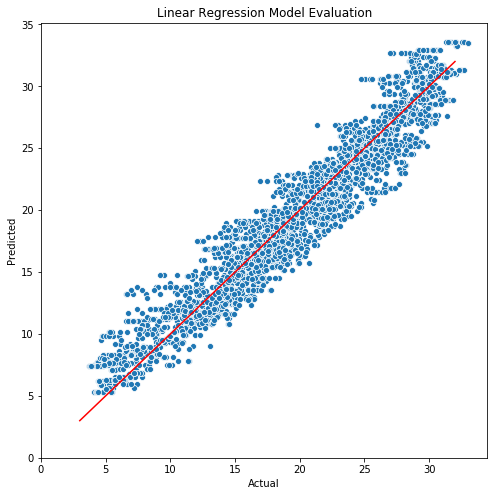

In [54]:
# attempt building linear model with cyclical month data
features = ["Year", "Month Sin", "Month Cos"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

As we can see, this model performed much better! We also can see that the model fits well linearly when just using time as features.  Now that we have a decent model, let's actually calculate from the model when each month will reach zero volume for the first time.  We can do this using the model linear intercept (b) and linear coefficients (m):

y = b + (m1 * x1) + (m2 * x2) + (m3 * x3)

We have the b and m values returned from the model and we saved those results in the results dataframe. If we assume that x1 represents the value of the year, x2 represents the value of the sin of the month, and x3 represents the value of the cos of the month, we can set y equal to zero, and solve for x1:

x1 = (-b - (m2 * x2) - (m3 * x3)) / m1

Let's write a function that will compute this given the intercepts and coefficients of the model, and we can then pass in each month into the function to predict what year each month will reach a volume of zero for the first time.

In [55]:
# zero_volume_predictor() will compute from linear regression model predictions when zero volume will be reached for 
# each month.  This function assumes that the coefficients are ordered like so: Year, Month Sin, and then Month Cos
def zero_volume_predictor(intercept, coefficients, month):
    # x1 = (-b - (m2 * x2) - (m3 * x3)) / m1
    return (-intercept - (coefficients[1] * np.sin((month-1)*(2.*np.pi/12))) - 
            (coefficients[2]*np.cos((month-1)*(2.*np.pi/12)))) / coefficients[0]

Now let's write a function that will predict zero volume for each month with a provided linear regression model.  Let's also find a way to visualize the results.

In [56]:
# predict_and_visualize_zero_volume will calculate the predicted years when each month will first experience zero
# volume sea ice.  It will then display a bar chart of the results. It will also return a data frame containing 
# the predicted values.
def predict_and_visualize_zero_volume(intercept, coefficients):
    # calculate year for first zero volume ice for each month and make a visual bar plot
    water_df = pd.DataFrame([zero_volume_predictor(intercept, coefficients[0:3], month) for month in range(1, 13)], 
                            range(1, 13), columns=["Year"])
    plt.figure(figsize=(24, 12))
    sns.barplot(x=water_df.Year, y=water_df.index, data=water_df, orient="h")
    plt.xlim(2020, 2120)
    plt.xlabel("Year")
    plt.ylabel("Month")
    plt.title("Prediction for Year when each Month will have Zero Volume for First Time")
    plt.show()
    # return predicted values
    water_df = water_df.reset_index()
    water_df.columns = ["Month", "Year"]
    water_df["Year"] = water_df["Year"].astype(int)
    return water_df

Let's predict when zero volume will occur for each month using our better model we've created:

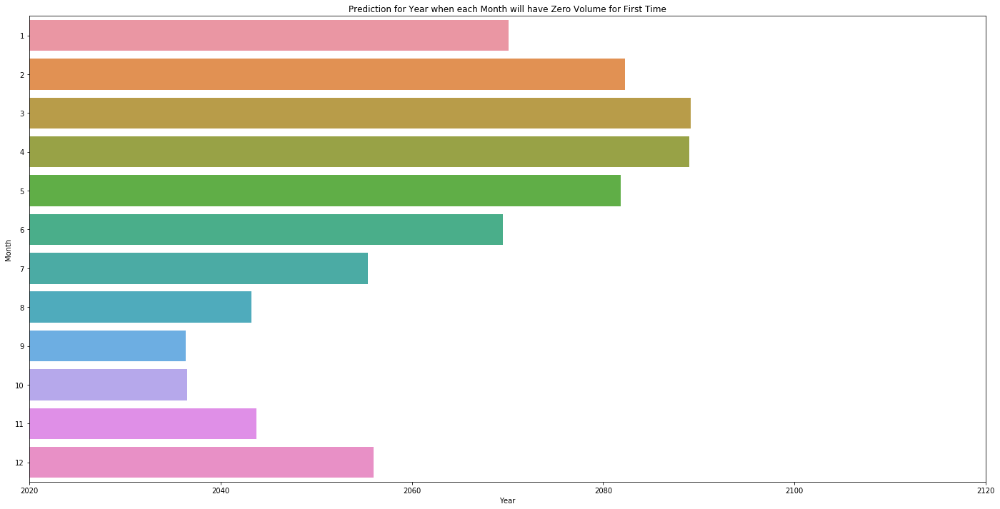

In [57]:
# make zero volume predictions for linear model that used Year, Month Sin, and Month Cos as features
zero_volume_predictions_df = predict_and_visualize_zero_volume(results_df.iloc[-1]["Linear Intercept"], 
                                                            results_df.iloc[-1]["Linear Coefficients"])

In [58]:
zero_volume_predictions_df

,Month,Year
0,1,2070
1,2,2082
2,3,2089
3,4,2089
4,5,2081
5,6,2069
6,7,2055
7,8,2043
8,9,2036
9,10,2036


This is all very interesting.  We can see that our better model, which used just a linear relationship between Arctic Sea Ice volume and time, predicts that 2036 will be the first year that that there will be no Arctic Sea Ice, for both the months of September and October.  We also see that 2089 is the predicted year that March will experience zero volume ice.  This would mean that after 2089, there would be no more Arctic Sea Ice year round.  The predictions agree with how the Arctic Sea Ice oscillates every year, with the minimum ice volume in September and the maximum ice volume in March.  Now that we have examined the linear relationship between Arctic Sea Ice volume and time, let's go ahead and see if we can build a better model.  We wanted to also take a look at the relationship between rate of ice volume loss and change in temperature.  We've discussed how this relationship is linear due to the nature of the physics.  Let's build a linear model that uses just the air temperatures and sea surface temperatures and see how that model compares with our previous model.

Features: ['Air Temperature', 'Sea Surface Temperature']
Label: Volume 

Mean Absolute Error: 3.2594346946761825
Mean Squared Error: 15.487458403641718
Root Mean Squared Error: 3.9354108303507167


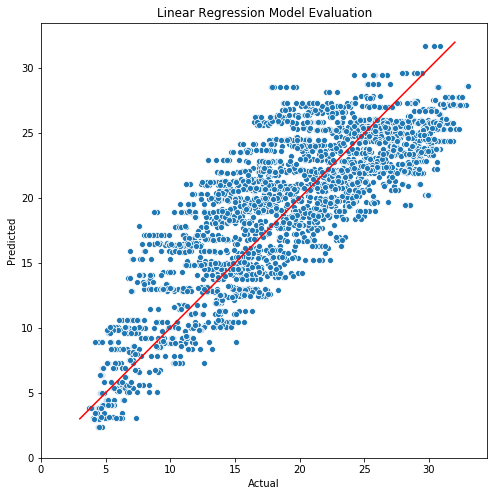

In [59]:
# build linear model with air temperatures and sea surface temperatures
features = ["Air Temperature", "Sea Surface Temperature"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

This model is poorer than the model that just used time, but we can clearly see from the actual and predicted values that this model fits well linearly.  This is fascinating knowing that the change of temperature is linear with how much ice has melted.  Let's go ahead now and create a linear regression model that combines time with temperature data and see how it compares to our time only model.

Features: ['Year', 'Month Sin', 'Month Cos', 'Air Temperature', 'Sea Surface Temperature']
Label: Volume 

Mean Absolute Error: 1.1472557290436287
Mean Squared Error: 2.1866754115189404
Root Mean Squared Error: 1.4787411577145408


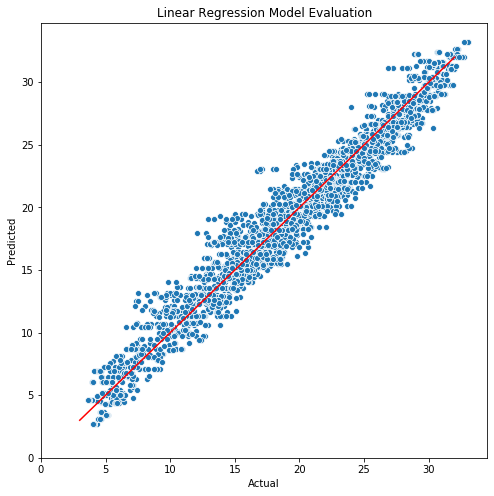

In [60]:
# build linear model with air temperatures and sea surface temperatures
features = ["Year", "Month Sin", "Month Cos", "Air Temperature", "Sea Surface Temperature"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

This is the best model we've created so far! Let's go ahead and use this new model to predict one last time when each month will reach zero volume.  We should note though that since there are now five coefficients in the linear equation (due to there being five features used to fit the model), we are only estimating what years the model predicts since we don't know what the future values of air temperature and sea surface temperatures will be.  In other words, we are not going to include the temperature linear model coefficients in the calculation.  We will keep that in mind as we look at the predictions.

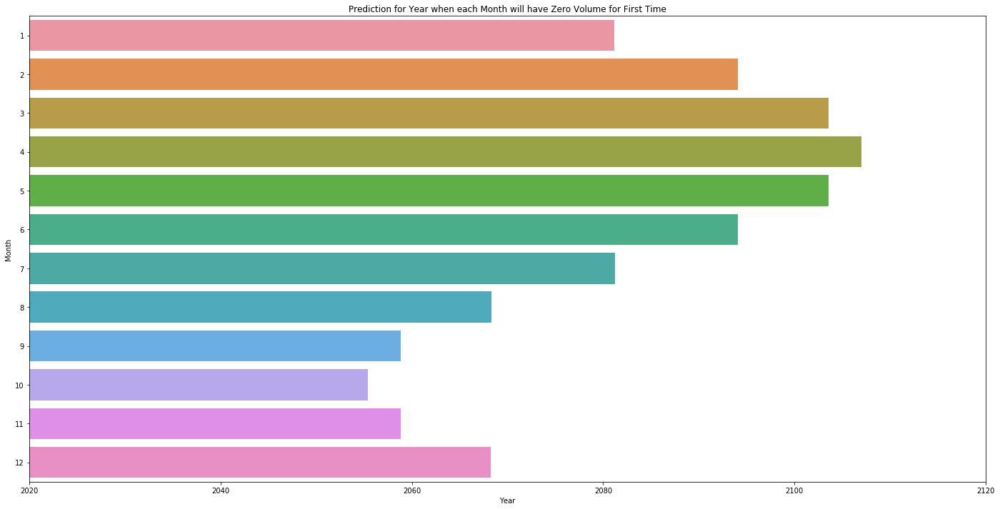

In [61]:
# make zero volume predictions for linear model that used Year, Month Sin, Month Cos, Air Temperature, and Sea
# Surface Temperatures as features
zero_volume_predictions_df = predict_and_visualize_zero_volume(results_df.iloc[-1]["Linear Intercept"], 
                                                            results_df.iloc[-1]["Linear Coefficients"])

In [62]:
zero_volume_predictions_df

,Month,Year
0,1,2081
1,2,2094
2,3,2103
3,4,2107
4,5,2103
5,6,2094
6,7,2081
7,8,2068
8,9,2058
9,10,2055


Surprisingly, this model predicts that October, not September, will be the first month that experiences zero volume ice, in the year 2055.  It also shifts so that April, not March, will be the last month that experiences zero volume ice, in the year 2107.  It would be helpful to look at the coefficients of the temperatures that we ignored when calculating the predictions to see how much weight they would have had on the prediction calculation.

In [63]:
# display latest model linear coefficients
results_df.iloc[-1]["Linear Coefficients"]

array([-2.30532330e-01,  5.95238074e+00, -1.51800700e-03, -2.29236655e-01,
       -2.57519902e+00])

It seems that the sea surface temperatures had a bigger weight on the prediction calculation, and so we have to remember that when looking at the new zero volume ice predictions.  Nonetheless, it is still intriguing to see the delay in years in the predictions, as well as the shift of which months will experience zero volume ice first and last.  We discussed earlier how a change in greenhouse concentrations is logarithmically proportional to a change in temperature, which means that it is logarithmically proportional to the rate of ice loss.  Let's confirm this by building a linear regression machine learning model that uses just greenhouse gas data.

Features: ['Carbon Dioxide', 'Methane']
Label: Volume 

Mean Absolute Error: 5.481468617466667
Mean Squared Error: 39.97548020133906
Root Mean Squared Error: 6.322616562890641


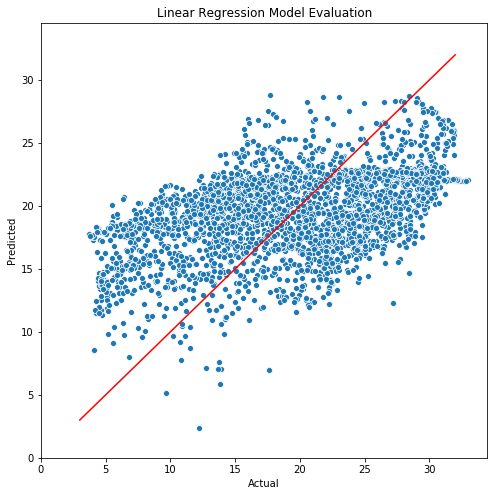

In [64]:
# build linear model with greenhouse gas concentrations
features = ["Carbon Dioxide", "Methane"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

This is the most atrocious model we've created.  We can see that it does not fit well linearly, which is what we expected.  We would need to build a non linear machine learning model to better predict the volume using just greenhouse gas concentrations.  In fact, adding these features along with our current best model hardly improves or degrades the model.

Features: ['Year', 'Month Sin', 'Month Cos', 'Air Temperature', 'Sea Surface Temperature', 'Carbon Dioxide', 'Methane']
Label: Volume 

Mean Absolute Error: 1.1261502073330105
Mean Squared Error: 2.1173081328010026
Root Mean Squared Error: 1.4550972932422774


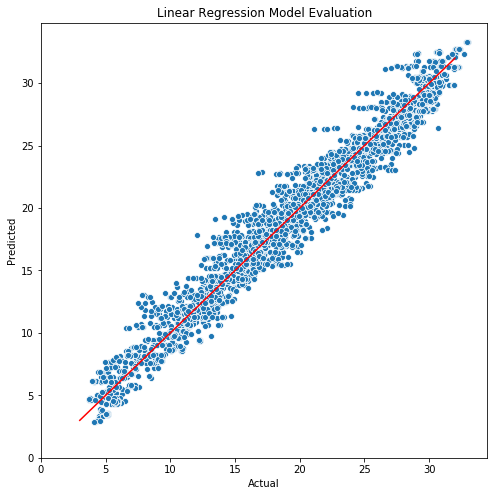

In [65]:
# build linear model with all data, excluding thickness and extent
features = ["Year", "Month Sin", "Month Cos", "Air Temperature", "Sea Surface Temperature", "Carbon Dioxide", "Methane"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

Before we take a look at the results dataframe and compare models, let's build one more model, using just thickness and extent.

Features: ['Thickness', 'Extent']
Label: Volume 

Mean Absolute Error: 0.5951187619501271
Mean Squared Error: 0.5802999730832368
Root Mean Squared Error: 0.7617742271061924


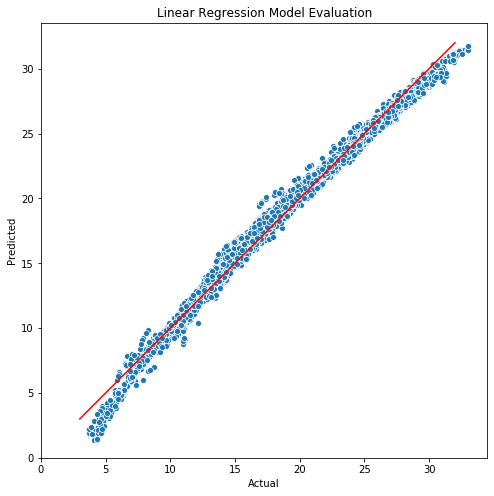

In [66]:
# build linear model with only thickness and extent
features = ["Thickness", "Extent"]
results_df = create_and_evaluate_linear_regression_model(arctic_sea_ice_df, features, label, results_df)

This is the best model we've built so far, but why? It most likely is because the model is "cheating", in that it has found the linear relationship between volume area and depth.  We know that volume is linearly proportional to both area (akin to extent) and depth (akin to thickness).  I believe this model performs so well due to this linear relationship, and which is why we have so far excluded these two features in all our models.  Now that we have built so many models using different features, let's take a look at the results dataframe for a final comparison.

In [67]:
# compare model results
results_df

,Features,Label,Linear Intercept,Linear Coefficients,Mean Absolute Error,Mean Squared Error,Root Mean Squared Error
0,"[Year, Month]",Volume,639.056017,"[-0.3058484700679162, -1.2683466990700814]",3.840415,19.202871,4.382108
1,"[Year, Month Sin, Month Cos]",Volume,628.675728,"[-0.30477447510094824, 7.9998982079050505, 2.2...",1.514158,3.707509,1.925489
2,"[Air Temperature, Sea Surface Temperature]",Volume,19.303673,"[-1.2667800313626247, -5.6517467954377745]",3.259435,15.487458,3.935411
3,"[Year, Month Sin, Month Cos, Air Temperature, ...",Volume,479.781900,"[-0.2305323302384969, 5.952380735919644, -0.00...",1.147256,2.186675,1.478741
4,"[Carbon Dioxide, Methane]",Volume,163.732015,"[0.10152446321873605, -0.09803011709892237]",5.481469,39.975480,6.322617
5,"[Year, Month Sin, Month Cos, Air Temperature, ...",Volume,545.931405,"[-0.26660425557050094, 5.961328783612858, 0.06...",1.126150,2.117308,1.455097
6,"[Thickness, Extent]",Volume,-15.053449,"[10.74673937392821, 1.3585532772733686]",0.595119,0.580300,0.761774


From the results table, we can see that our best model (excluding the last one with the Arctic Sea Ice thickness and extent) is the one that used features of time and temperature: Year, Month Sin, Month Cos, Air Temperature, and Sea Surface Temperature.  Adding greenhouse gases to the features doesn't add any value to predicting the Arctic Sea Ice volume.  This makes sense since time (apparently) and change in temperature are linearly proportional to change in ice volume, and greenhouse gas concentrations is non linearly proportional to change in ice volume.

__Conclusion__

We've been through a lot in this project.  We loaded all our different datasets about the Arctic Sea Ice and combined them together.  We then spent time determining how to clean up the data.  Once we had a clean dataset, we spent time exploring the data and making many plots to have a better understanding of what is in the data.  Finally, we used linear regression machine learning models to try and predict when Arctic Sea Ice will disappear.  Future analysis would take us into exploring the non linear relationship between greenhouse gas concentrations and volume of sea ice.  We would need to build a non linear machine learning model to do this.

At the conclusion of this data analysis, it is good to remind ourselves that Arctic Sea Ice is complex, and the data we have gathered here for analysis is a small fraction of all the variables that go into determining how much ice there is.  With that being said, we gained much insight on the current state of the Arctic Sea Ice.